In [1]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import numpy as np
from scipy import ndimage as ndi
import skimage
from skimage import io, filters, morphology
import pandas as pd
import glob
import random
import seaborn as sns
from scipy import stats
from scipy.signal import chirp, find_peaks, peak_widths
from pathlib import Path
import scipy.stats
import os
from scipy import ndimage
import math
from operator import itemgetter
from matplotlib import pyplot
#from read_roi import read_roi_zip
from scipy.optimize import curve_fit
from scipy import signal
from scipy.interpolate import interp1d, splev, CubicSpline, PPoly
import matplotlib.ticker as ticker
from matplotlib.lines import Line2D


In [2]:
#define functions

In [3]:
def display(im3d, cmap="gray", step=1, chosen = None):
    if chosen is None: 
        chosen = []
    stack_size = im3d.shape[0]
    cols = 5
    rows = math.ceil((stack_size/cols))
    
    h , axes = plt.subplots(nrows=rows, ncols=cols, figsize=(3*cols, 3*rows))
    #print(h)
    #p1 = get(h,'Position')
    #annotation('rectangle',p1,'FaceAlpha',.2,'FaceColor','red','EdgeColor','red') 
    vmin = im3d.min()
    vmax = im3d.max()
    enum = 0
    for ax, image in zip(axes.flatten(), im3d[::step]):
        ax.imshow(image, cmap=cmap, vmin=vmin, vmax=vmax)
        if enum in chosen:
            for axis in ['top','bottom','left','right']:
                #ax.spines[axis].set_linewidth(0.5)
                ax.spines[axis].set_color("red")
                ax.spines[axis].set_linewidth(5)
        ax.set_xticks([])
        ax.set_yticks([])
        enum += 1
    #plt.savefig('foo.png')
    

In [4]:
def display_slice(im, cmap="gray", step=1, chosen = None, savefig = False):
    h , axes = plt.subplots(1,1)
    vmin = im.min()
    vmax = im.max()
    enum = 0
    axes.imshow(im, cmap=cmap, vmin=vmin, vmax=vmax)

In [5]:
#functions to get the peak indexes for a particular channel

#get indexes of peaks for edu and hoechst channels in an array, the midpoint is the sum of the peak indexes divided by 2. Can be then converted into a distance.
def get_index(a, b):
    return (a+b)/2

#get the index of a single channel
def get_index_single_axis(a):
    return (a)

#get indexes of peaks for split smc4 or scc1 peaks for subsequent alignment the midpoint is the sum of the peak indexes divided by 2. Can be then converted into a distance.

def get_index_centre_split_axes(a,b):
    return (a+b)/2

In [6]:
#wapl depleted cells - exclude profiles where more than one peak is detected

58.5 59
51 0.7443939393939394


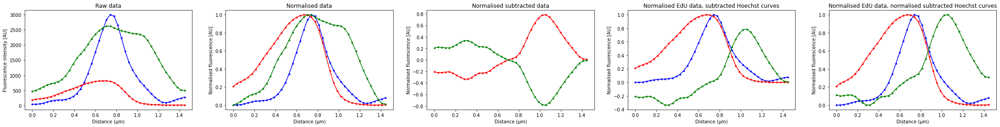

0    0.394091
dtype: float64
51.0 51
57 0.7715151515151515


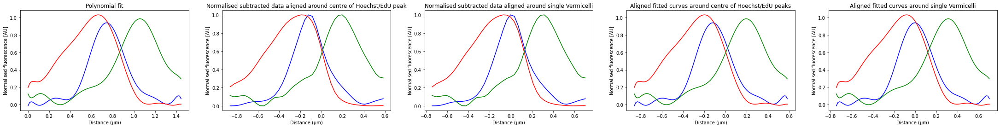

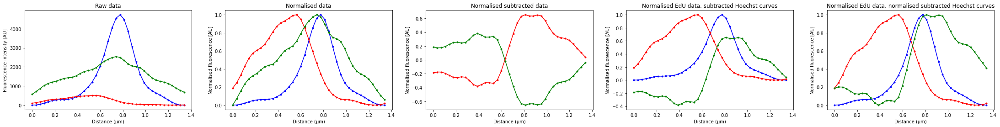

0    0.394091
1    0.351919
dtype: float64


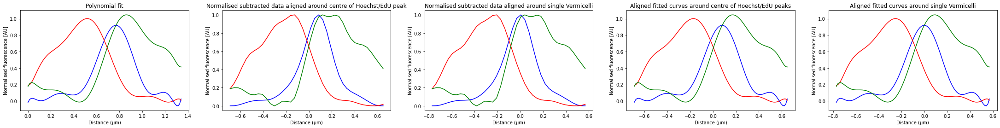

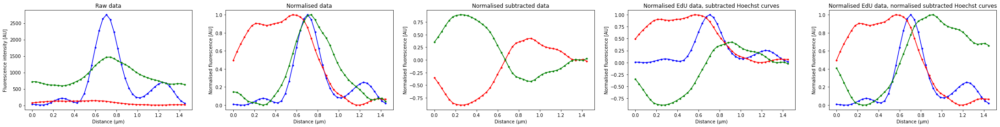

0    0.394091
1    0.351919
dtype: float64
45.5 46
52 0.6297777777777779


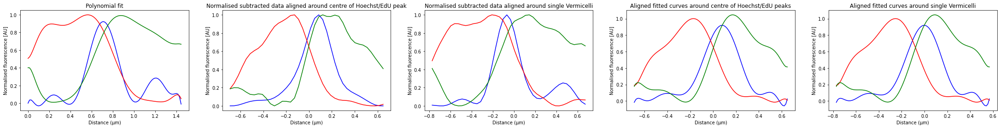

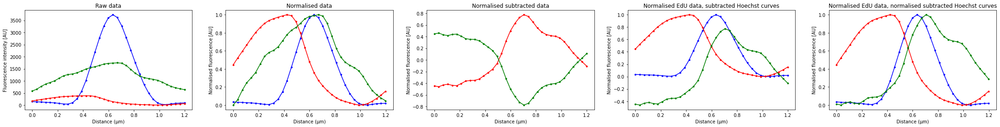

0    0.394091
1    0.351919
2    0.327000
dtype: float64
47.5 48
50 0.7121212121212122


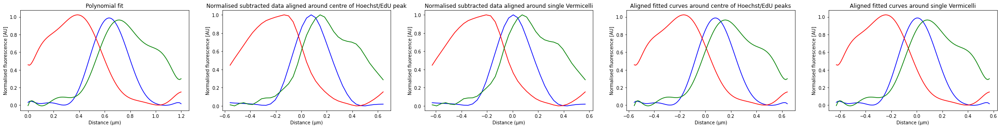

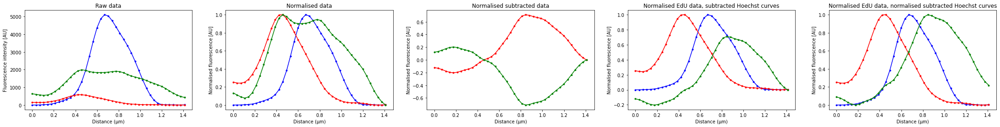

0    0.394091
1    0.351919
2    0.327000
3    0.441515
dtype: float64
53.0 53
52 0.7038383838383838


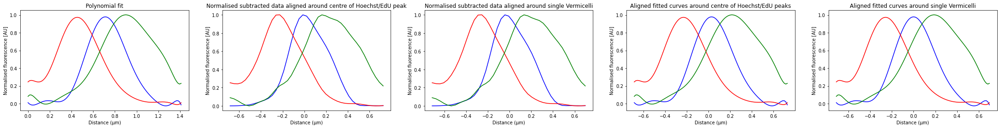

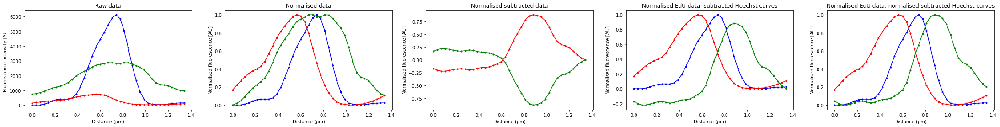

0    0.394091
1    0.351919
2    0.327000
3    0.441515
4    0.351919
dtype: float64
67.5 68
64 0.9574141414141415


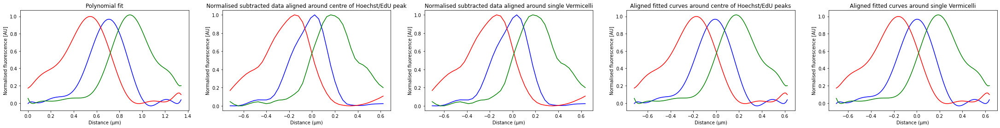

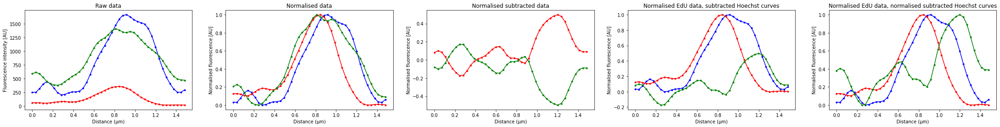

0    0.394091
1    0.351919
2    0.327000
3    0.441515
4    0.351919
5    0.344071
dtype: float64
51.0 51
50 0.6055555555555556


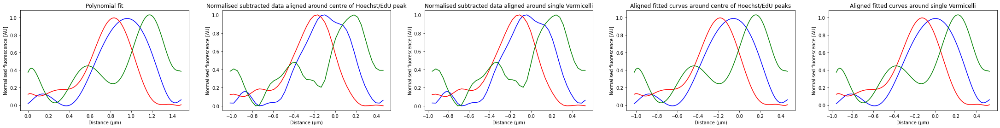

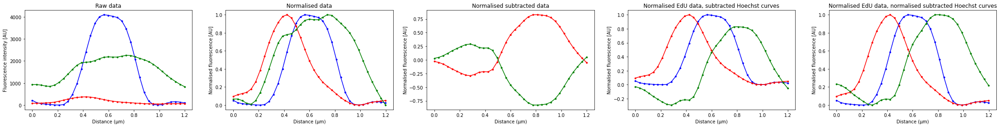

0    0.394091
1    0.351919
2    0.327000
3    0.441515
4    0.351919
5    0.344071
6    0.411778
dtype: float64
53.5 54
54 0.7112727272727274


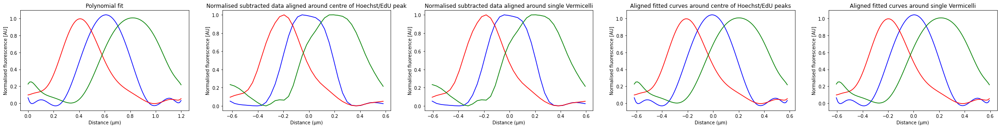

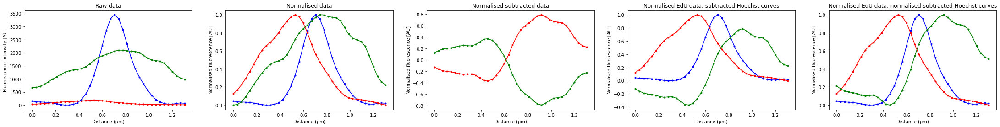

0    0.394091
1    0.351919
2    0.327000
3    0.441515
4    0.351919
5    0.344071
6    0.411778
7    0.381980
dtype: float64
46.0 46
51 0.581090909090909


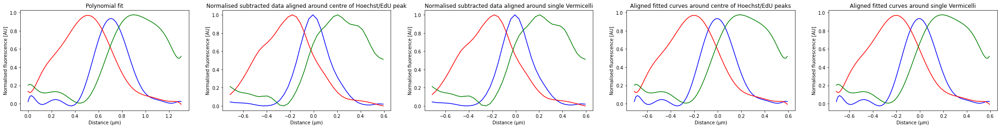

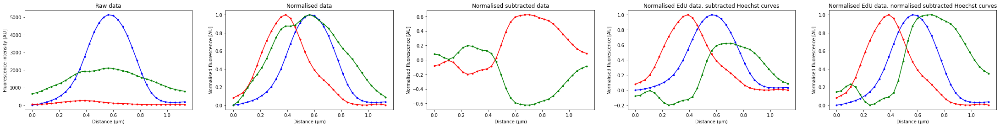

0    0.394091
1    0.351919
2    0.327000
3    0.441515
4    0.351919
5    0.344071
6    0.411778
7    0.381980
8    0.319030
dtype: float64


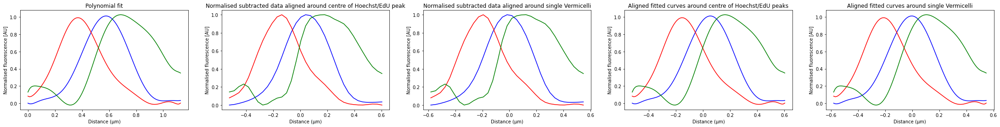

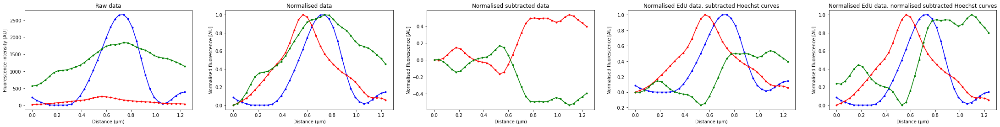

0    0.394091
1    0.351919
2    0.327000
3    0.441515
4    0.351919
5    0.344071
6    0.411778
7    0.381980
8    0.319030
dtype: float64
53.0 53
48 0.8033939393939394


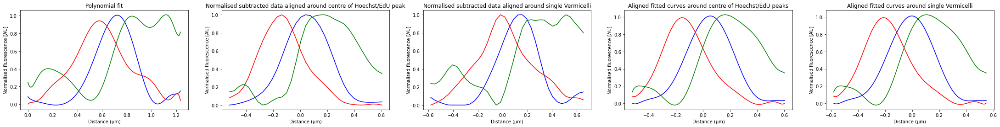

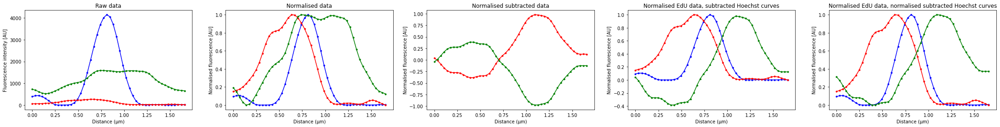

0    0.394091
1    0.351919
2    0.327000
3    0.441515
4    0.351919
5    0.344071
6    0.411778
7    0.381980
8    0.319030
9    0.502121
dtype: float64
61.0 61
53 0.6981010101010101


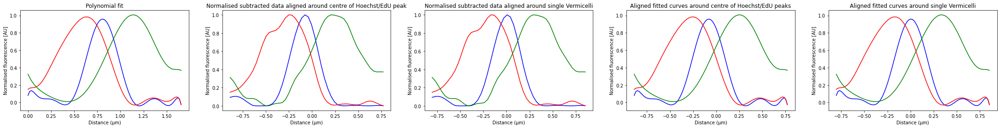

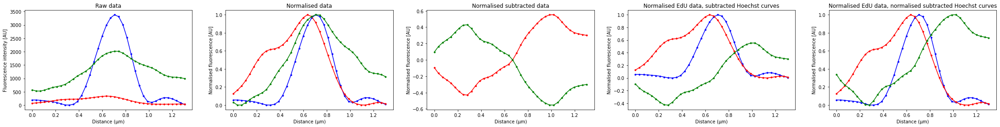

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
dtype: float64
54.5 55
53 0.6981010101010101


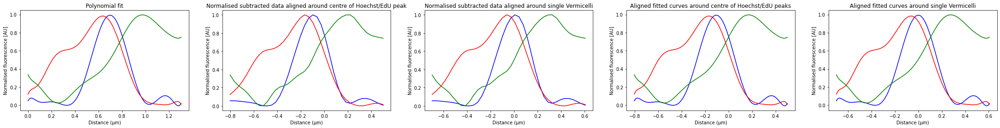

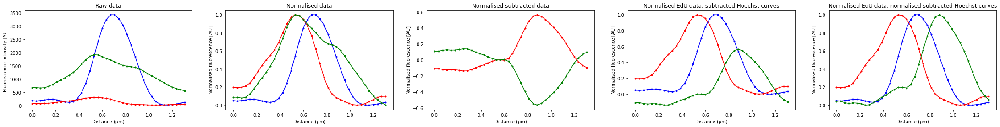

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
dtype: float64
57.5 58
57 0.7715151515151515


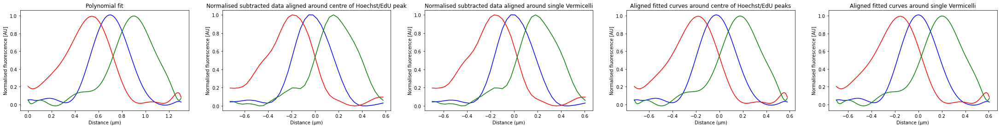

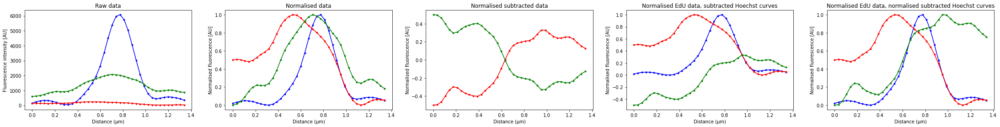

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
dtype: float64
56.0 56
64 0.980040404040404


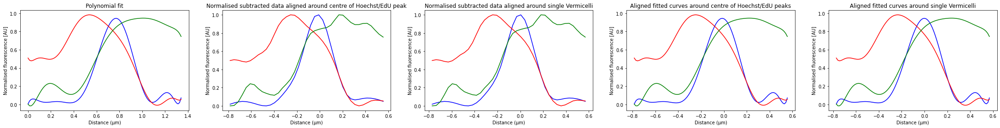

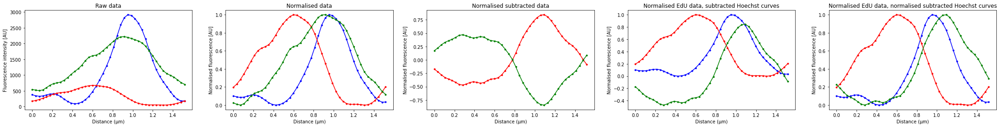

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
dtype: float64
55.0 55
46 0.47486868686868683


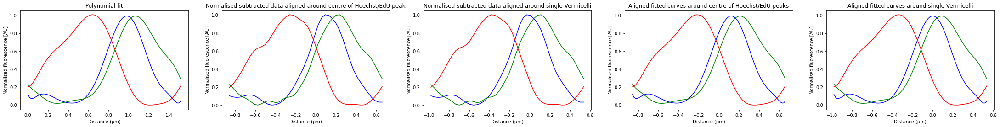

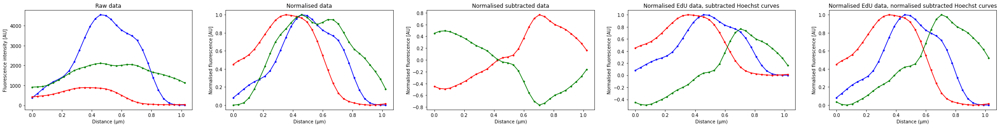

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
dtype: float64
50.5 51
50 0.6232323232323232


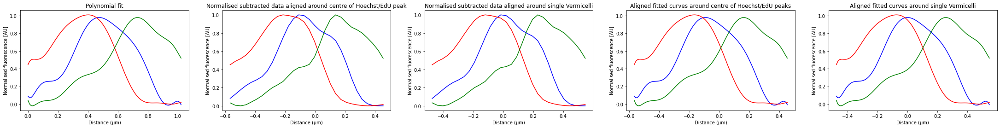

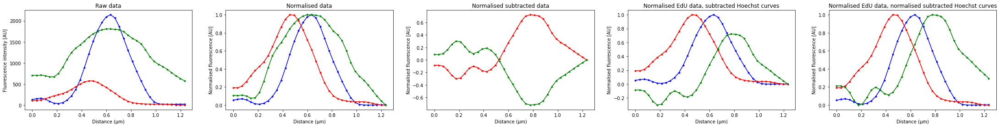

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
dtype: float64
46.5 47
57 0.5072424242424243


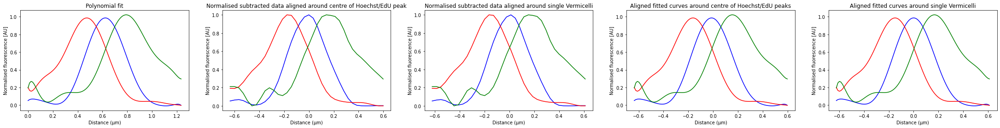

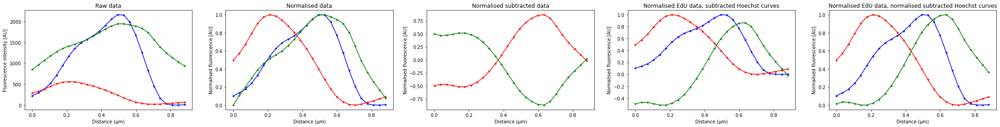

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
dtype: float64
51.0 51
50 0.5873737373737374


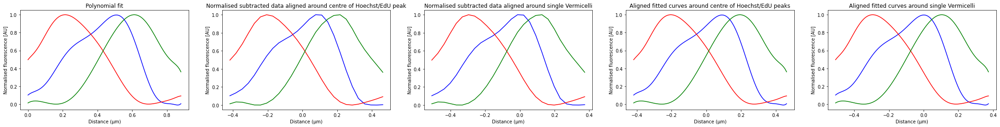

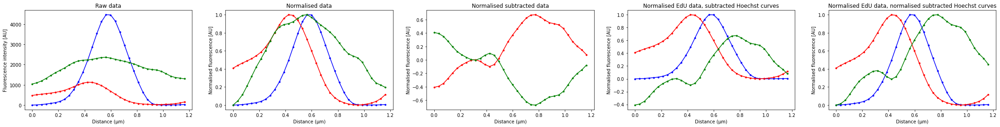

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
dtype: float64
59.5 60
54 0.75


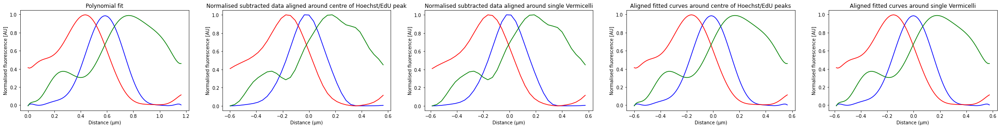

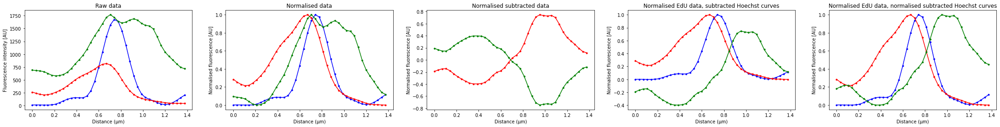

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
dtype: float64
51.5 52
45 0.6409090909090909


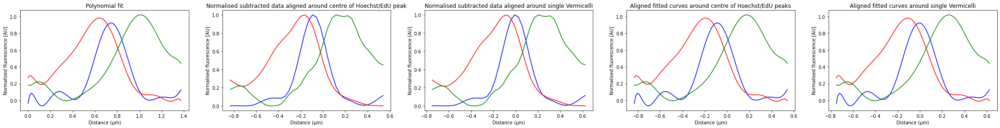

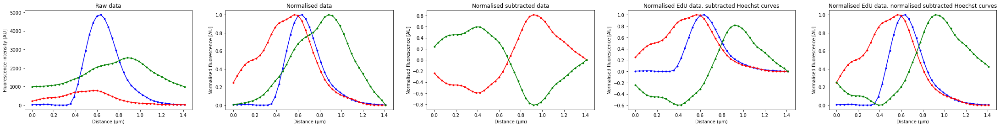

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
dtype: float64
54.5 55
53 0.641888888888889


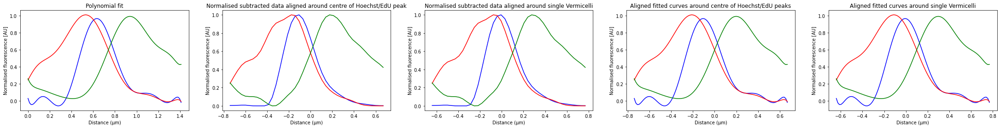

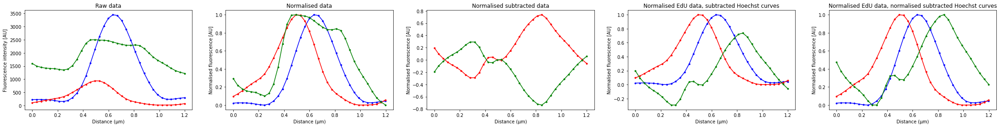

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
dtype: float64


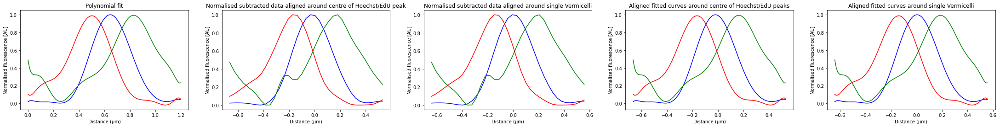

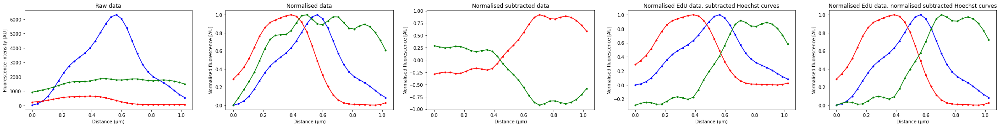

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
dtype: float64
57.5 58
62 0.8391919191919193


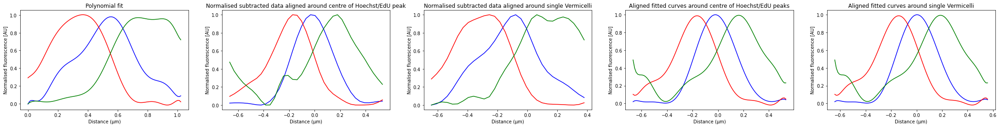

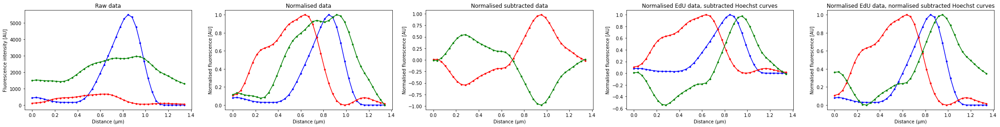

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
dtype: float64
51.5 52
55 0.705


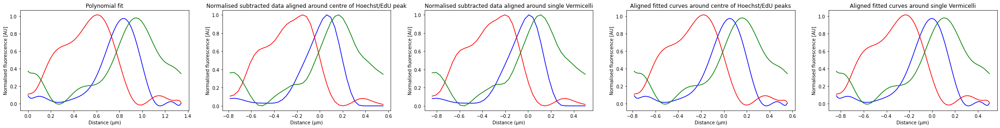

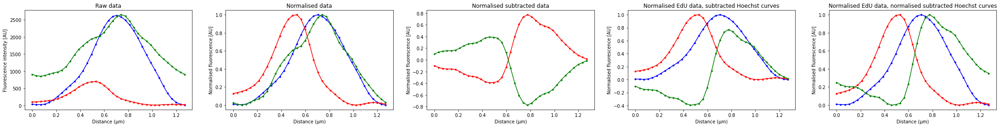

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
dtype: float64
52.0 52
49 0.5583030303030302


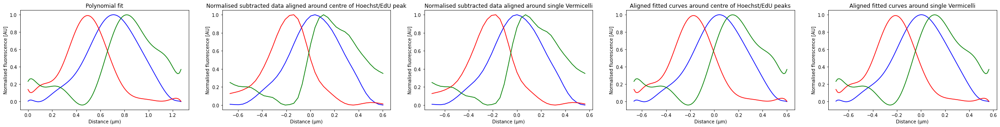

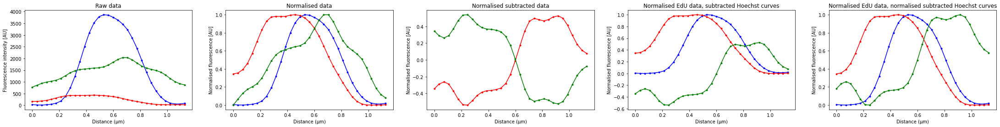

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
dtype: float64
60.5 61
59 0.9034747474747474


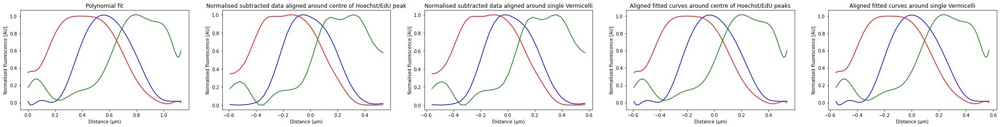

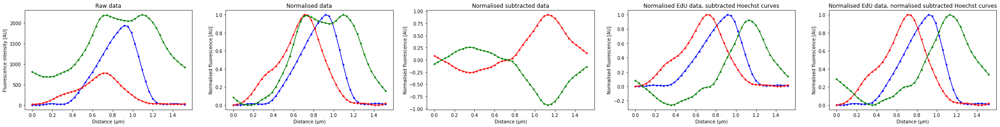

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
dtype: float64
46.0 46
62 0.6625858585858586


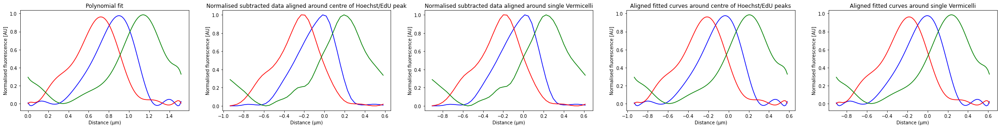

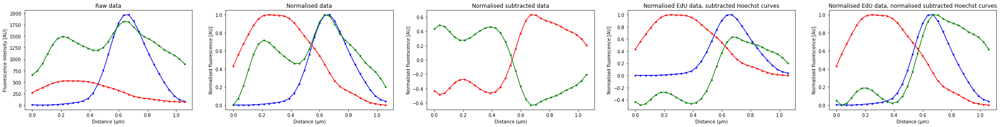

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
dtype: float64
50.5 51
47 0.5858383838383838


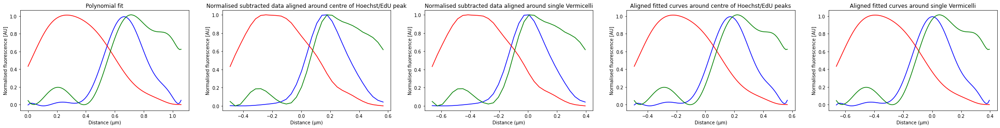

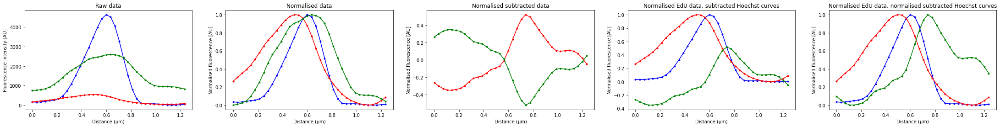

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
dtype: float64
47.0 47
52 1.0000808080808081


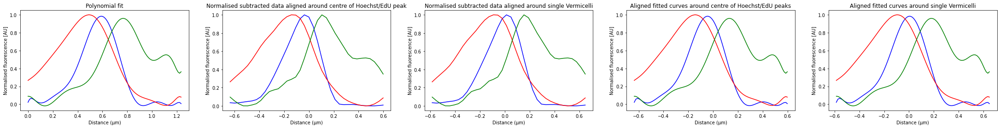

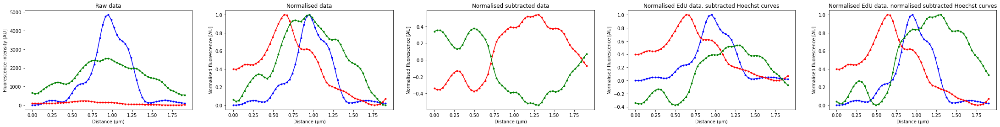

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
dtype: float64
55.0 55
53 0.9438282828282828


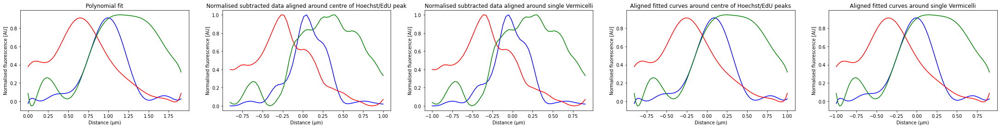

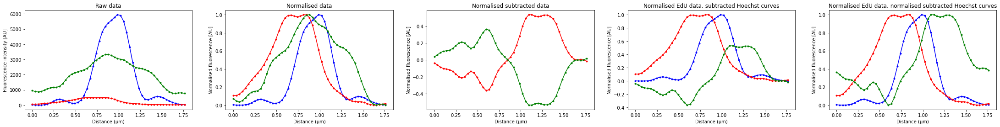

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
dtype: float64


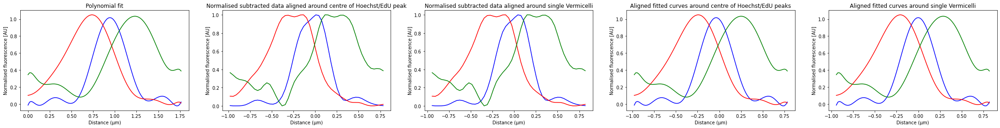

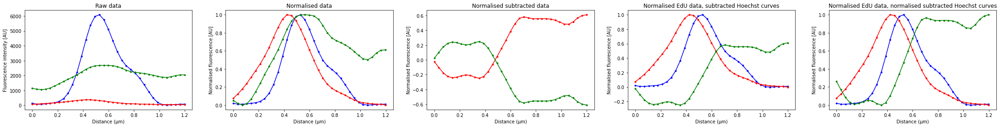

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
dtype: float64


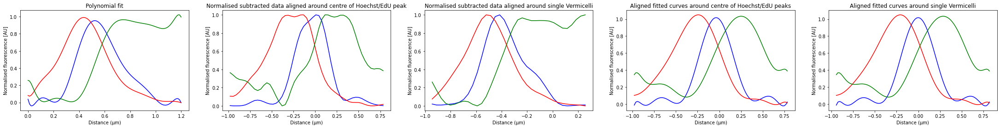

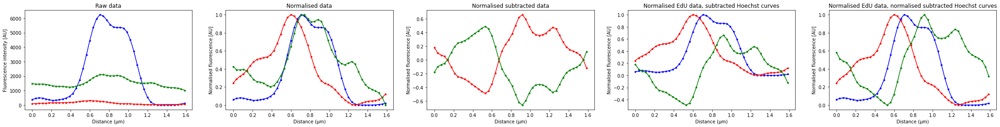

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
dtype: float64
39.5 40
46 0.7044040404040404


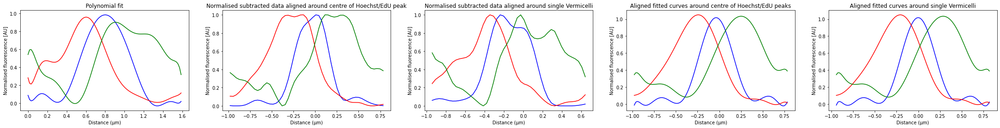

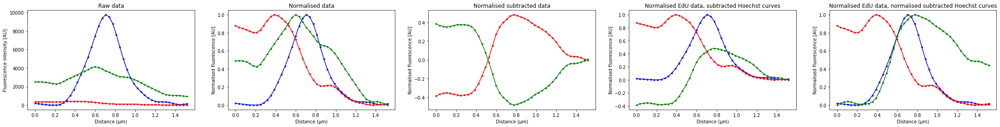

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
dtype: float64


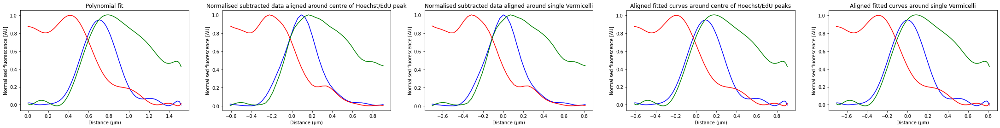

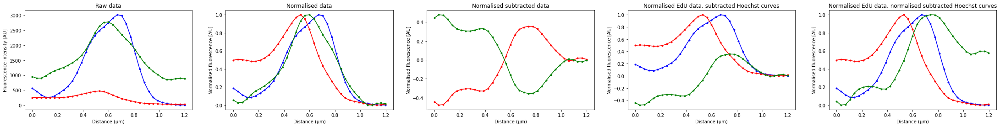

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
dtype: float64
53.5 54
58 1.0533737373737375


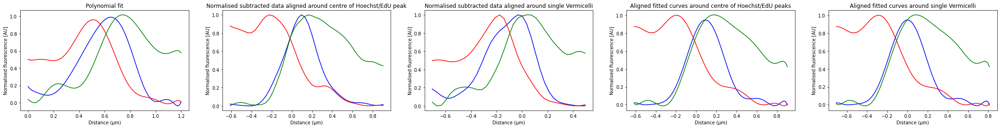

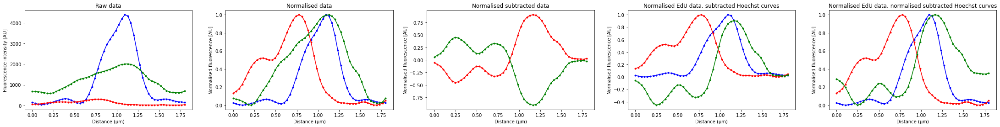

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
dtype: float64
54.5 55
54 0.6730909090909091


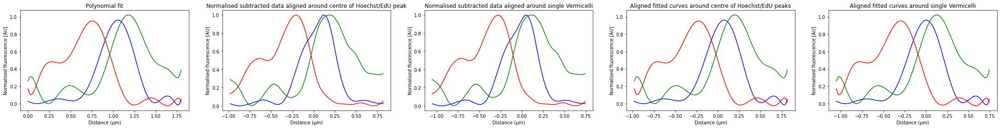

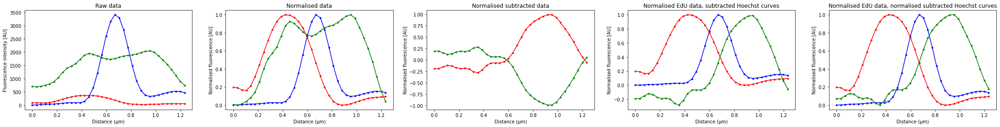

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
dtype: float64
54.0 54
53 0.7735858585858586


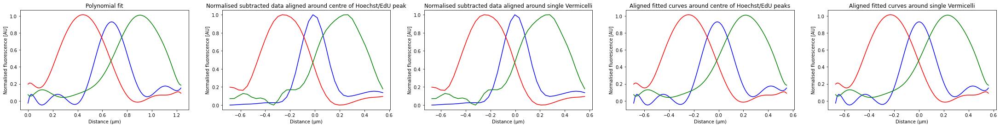

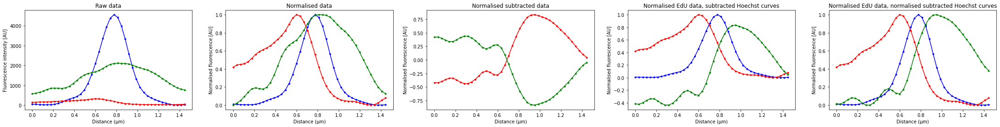

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
dtype: float64
60.5 61
57 0.7104848484848485


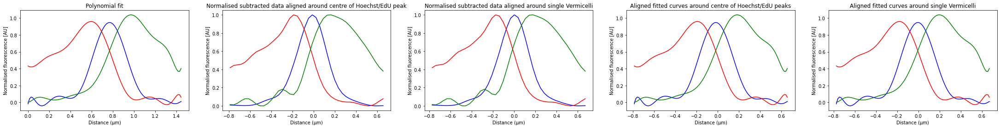

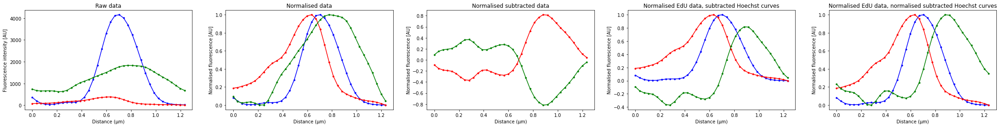

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
dtype: float64


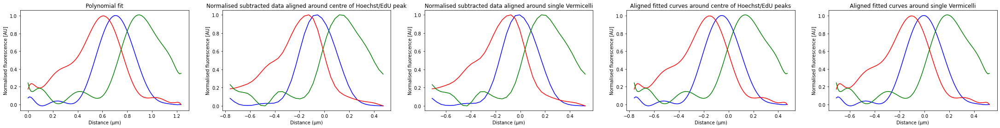

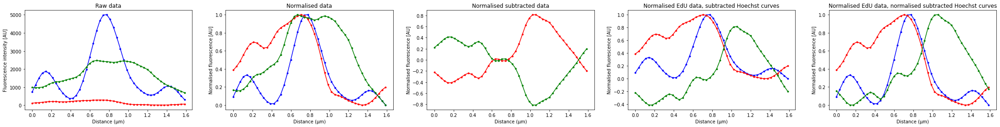

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
dtype: float64
65.5 66
69 0.9088484848484849


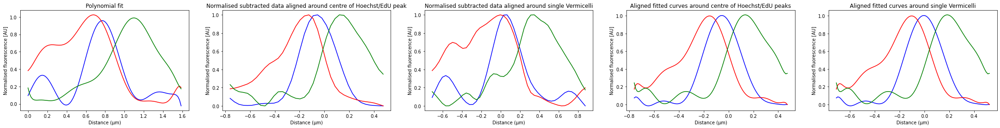

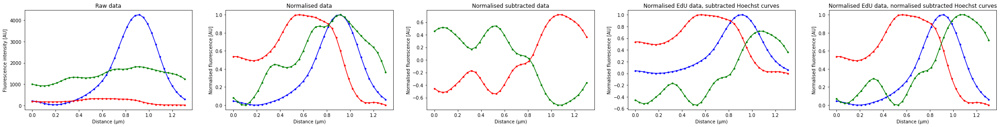

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
dtype: float64
62.0 62
62 0.8166464646464647


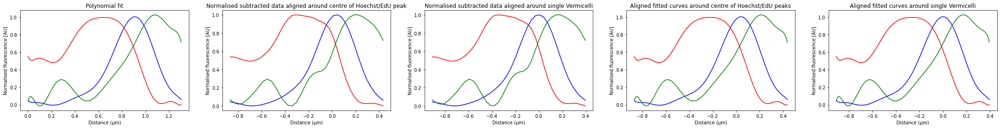

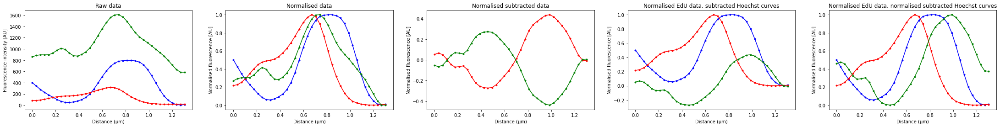

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
dtype: float64
54.0 54
56 0.7376161616161617


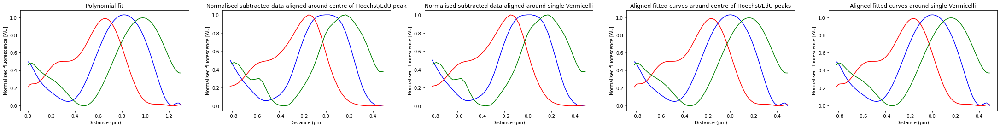

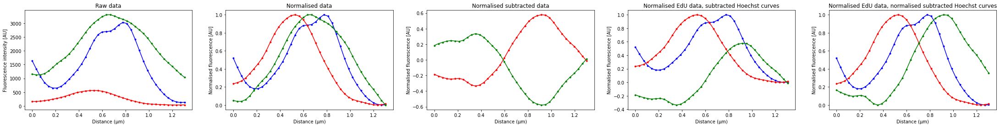

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
dtype: float64


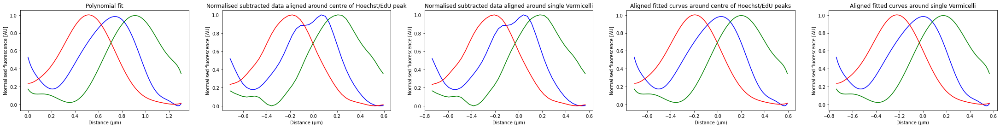

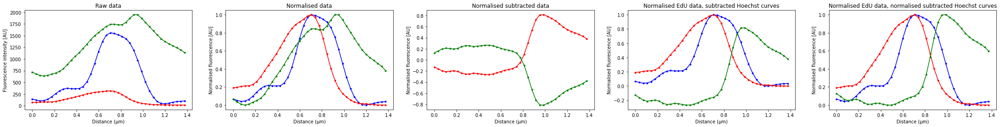

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
dtype: float64
47.0 47
53 0.7928585858585859


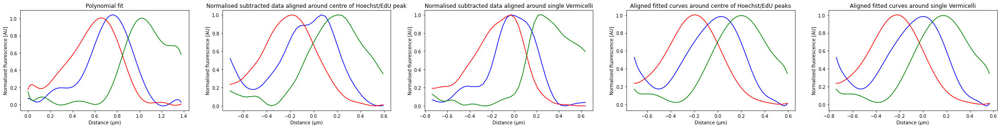

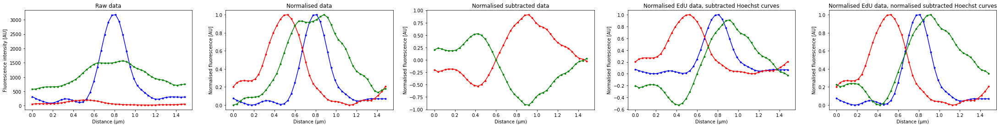

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
dtype: float64
61.5 62
49 0.628090909090909


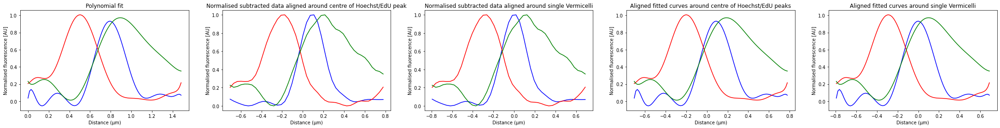

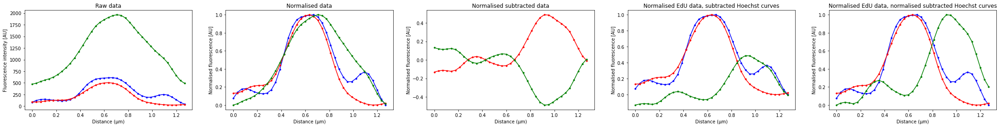

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
dtype: float64
55.0 55
48 0.6496969696969697


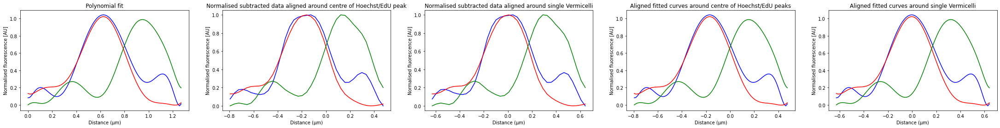

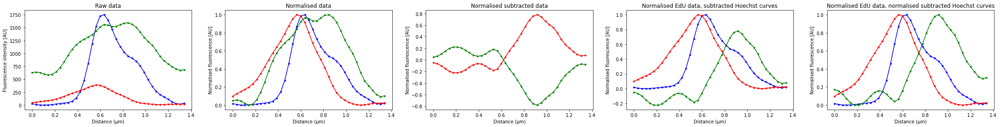

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
dtype: float64
59.5 60
66 0.94


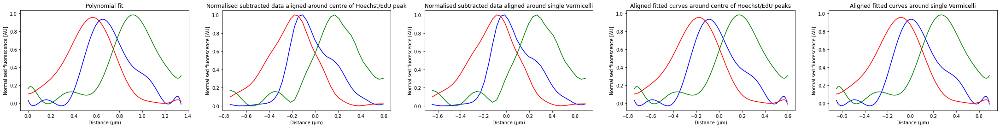

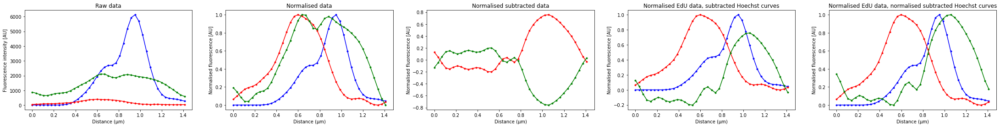

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
dtype: float64


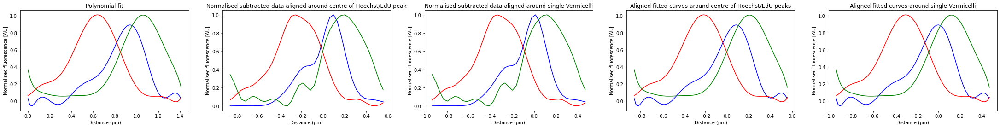

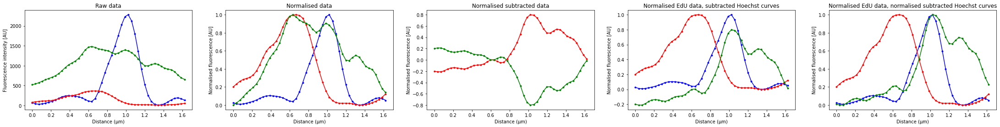

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
dtype: float64
52.0 52
55 0.9011111111111112


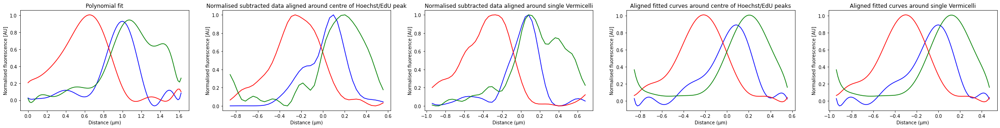

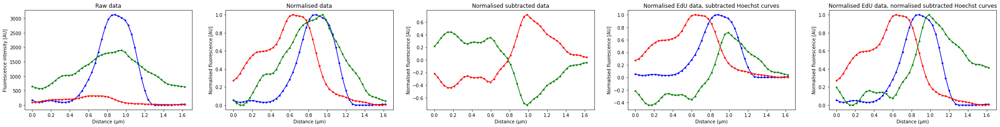

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
dtype: float64


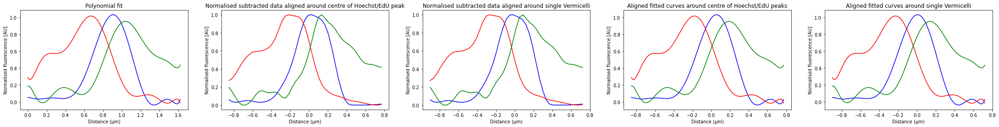

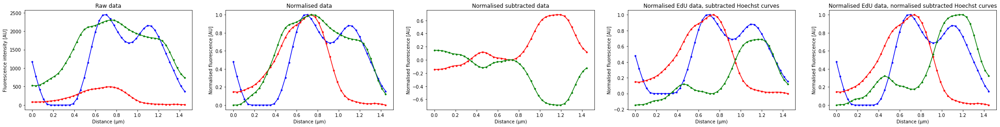

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
dtype: float64
59.5 60
68 0.9684848484848485


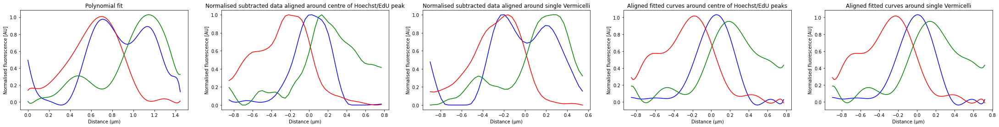

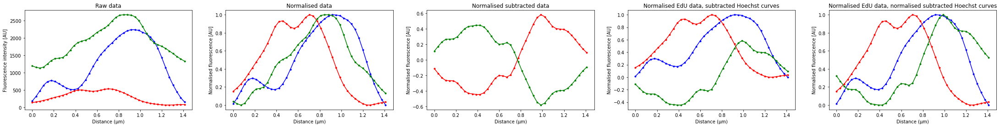

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
dtype: float64


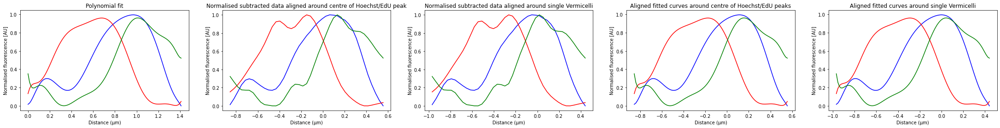

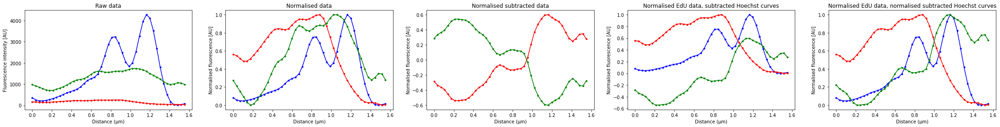

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
dtype: float64
50.5 51
46 0.7536565656565658


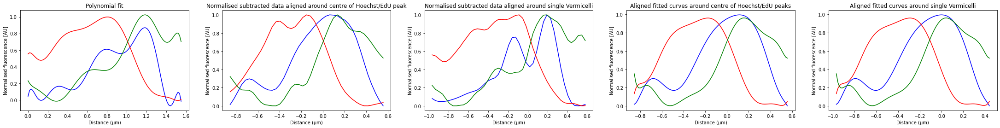

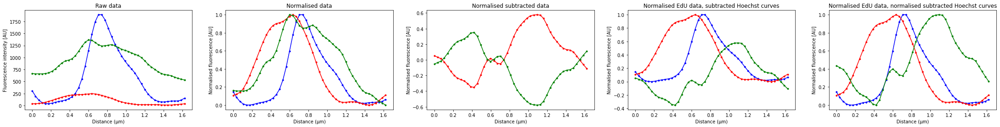

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
dtype: float64
51.5 52
46 0.7861818181818182


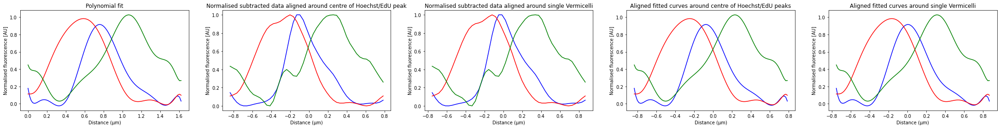

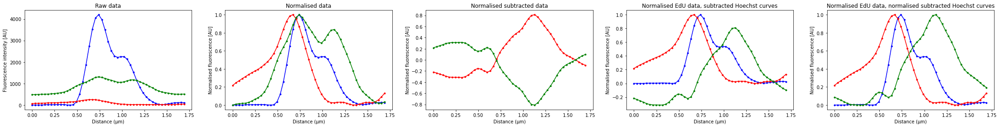

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
dtype: float64
58.5 59
52 0.8330505050505052


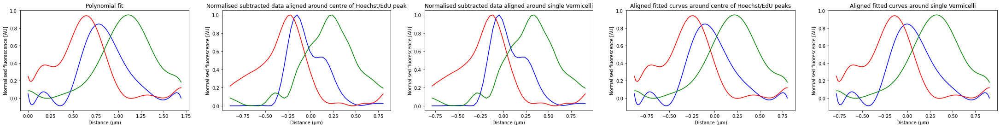

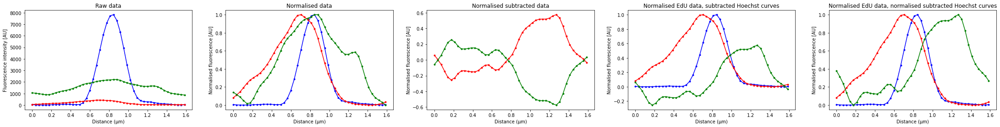

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
dtype: float64
54.5 55
52 1.0000808080808081


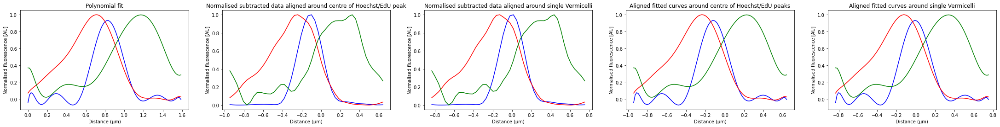

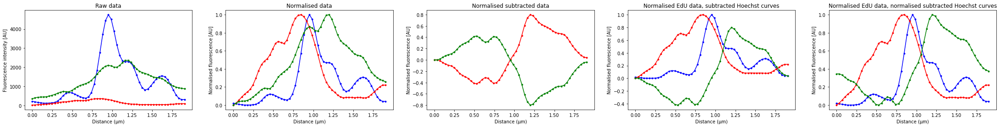

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
dtype: float64
55.0 55
59 0.9875050505050506


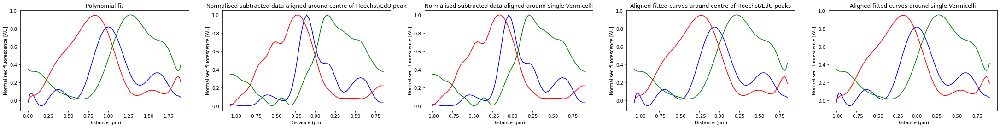

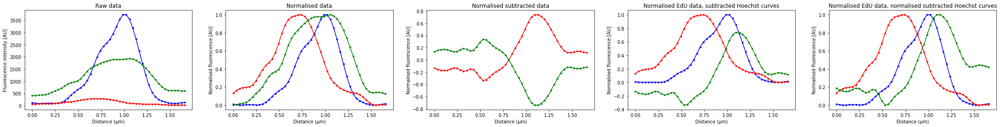

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
dtype: float64
57.5 58
51 0.7989999999999999


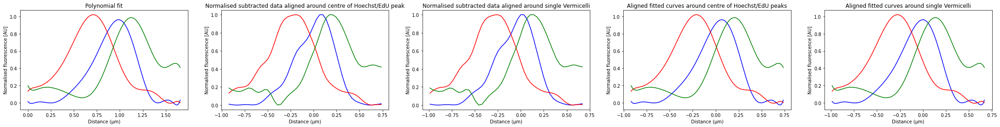

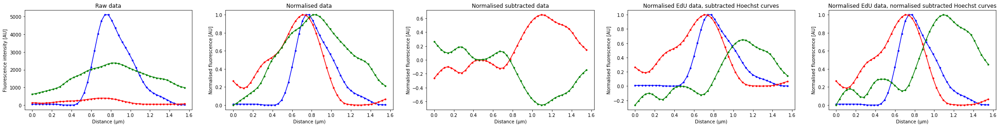

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
dtype: float64
57.5 58
56 0.976888888888889


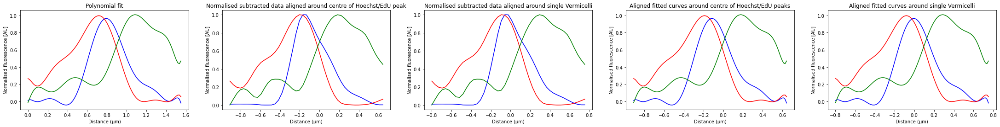

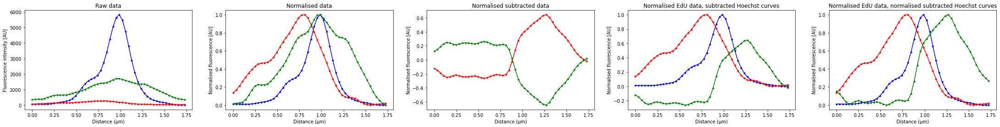

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
dtype: float64
50.5 51
54 0.846


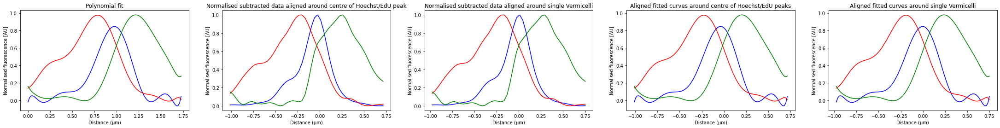

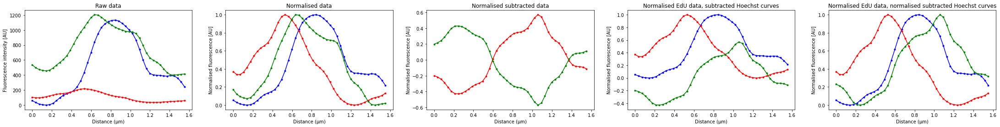

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
dtype: float64
53.5 54
52 0.7962828282828283


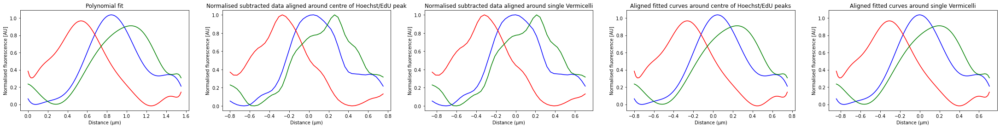

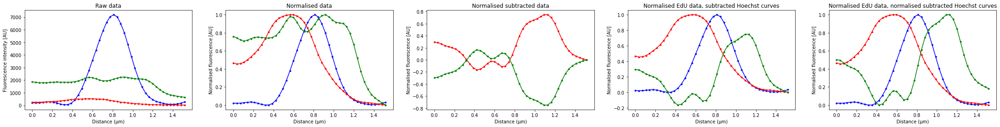

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
dtype: float64
56.5 57
51 0.7989999999999999


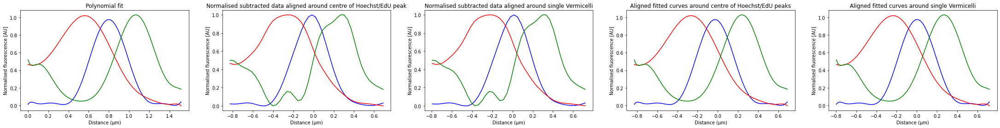

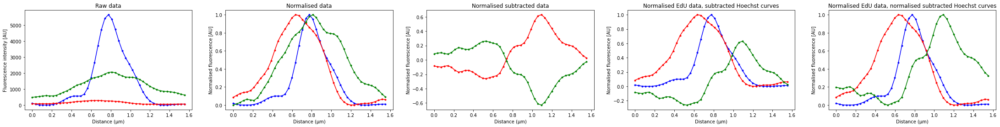

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
dtype: float64
54.5 55
53 0.7173737373737374


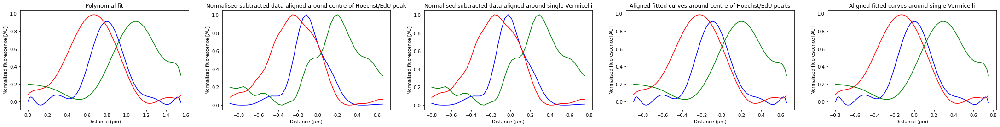

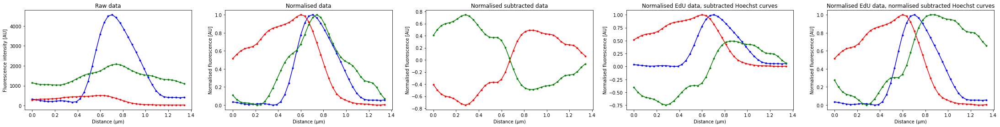

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
53    0.311313
dtype: float64
63.5 64
58 0.8465656565656566


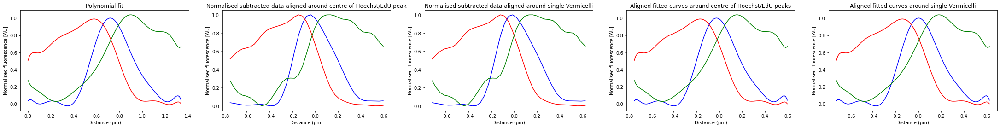

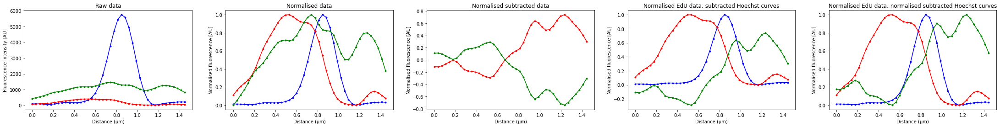

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
53    0.311313
54    0.686010
dtype: float64


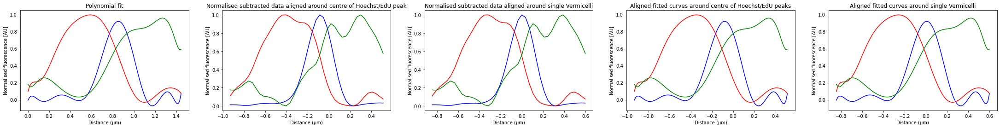

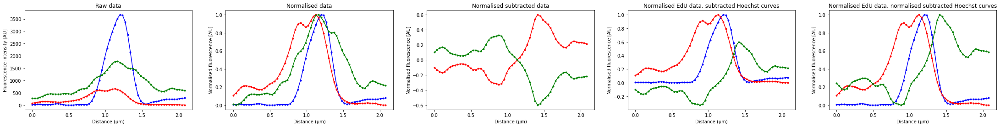

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
53    0.311313
54    0.686010
dtype: float64
54.5 55
63 0.8972727272727272


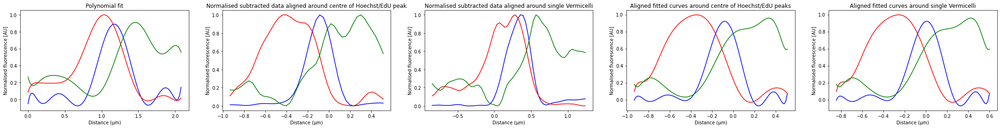

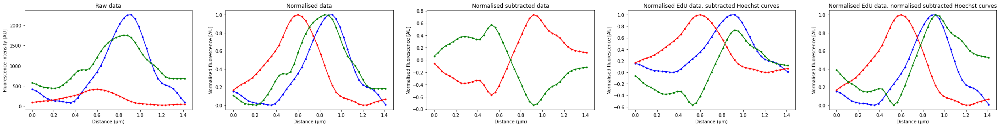

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
53    0.311313
54    0.686010
55    0.327576
dtype: float64
58.0 58
56 1.1765656565656566


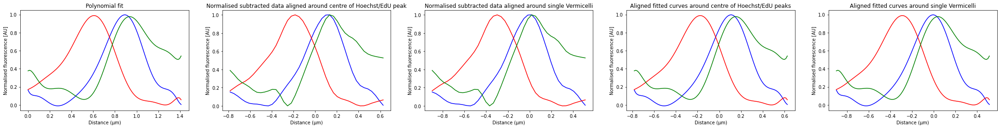

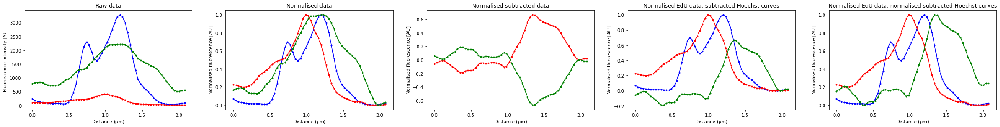

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
53    0.311313
54    0.686010
55    0.327576
56    0.420202
dtype: float64


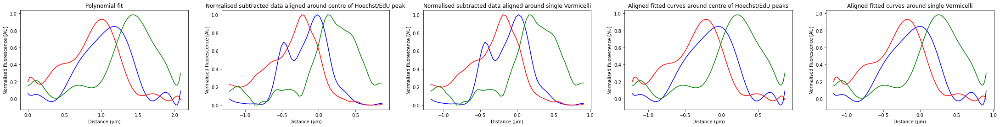

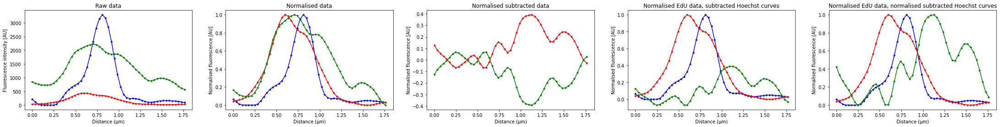

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
53    0.311313
54    0.686010
55    0.327576
56    0.420202
dtype: float64
54.0 54
53 1.0380505050505051


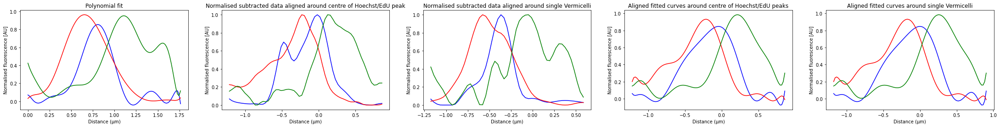

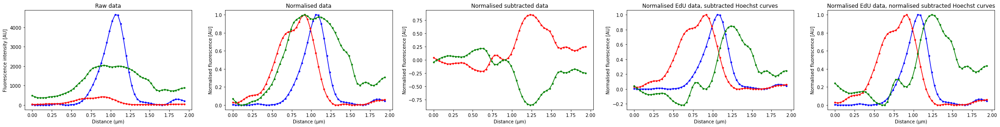

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
53    0.311313
54    0.686010
55    0.327576
56    0.420202
57    0.430889
dtype: float64
50.0 50
52 0.8330505050505052


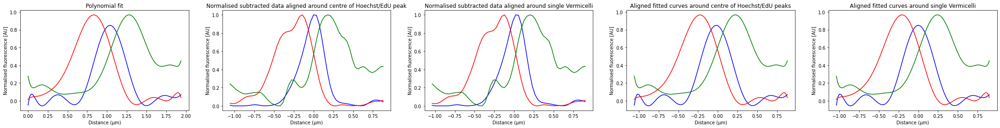

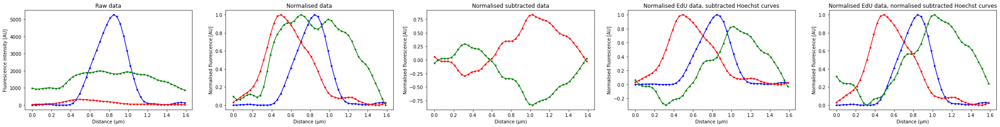

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
53    0.311313
54    0.686010
55    0.327576
56    0.420202
57    0.430889
58    0.544687
dtype: float64
60.5 61
60 0.9830303030303031


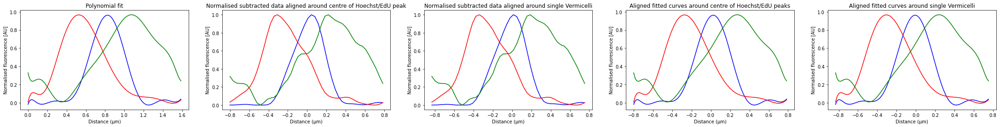

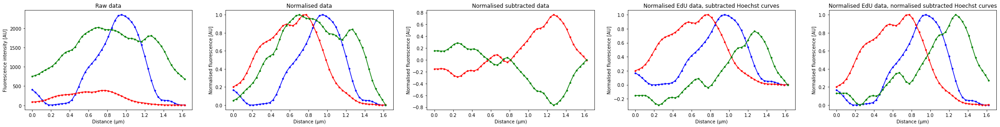

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
5     0.344071
6     0.411778
7     0.381980
8     0.319030
9     0.502121
10    0.342465
11    0.355636
12    0.473737
13    0.428768
14    0.330343
15    0.311616
16    0.400455
17    0.328929
18    0.375000
19    0.413030
20    0.327000
21    0.338384
22    0.320455
23    0.410182
24    0.413455
25    0.448848
26    0.286687
27    0.500040
28    0.498626
29    0.382828
30    0.417717
31    0.461192
32    0.379495
33    0.286687
34    0.434667
35    0.316121
36    0.395152
37    0.388949
38    0.320455
39    0.351919
40    0.413030
41    0.360444
42    0.327576
43    0.475131
44    0.461455
45    0.464586
46    0.442343
47    0.401697
48    0.360333
49    0.436111
50    0.517000
51    0.505333
52    0.423000
53    0.311313
54    0.686010
55    0.327576
56    0.420202
57    0.430889
58    0.544687
59    0.540667
dtype: float64
56.5 57
54 0.8650909090909091


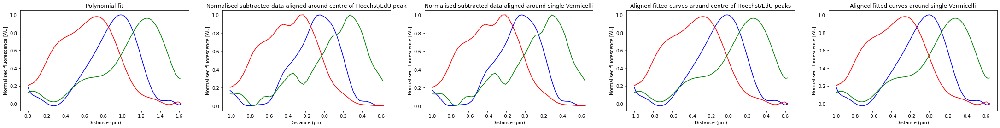

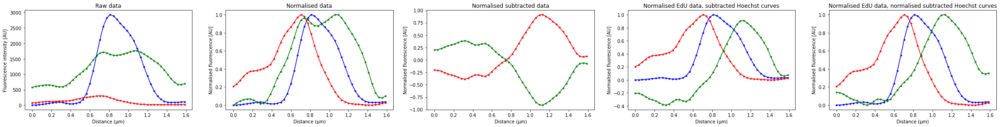

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
56    0.420202
57    0.430889
58    0.544687
59    0.540667
60    0.464586
Length: 61, dtype: float64
54.0 54
53 1.0380505050505051


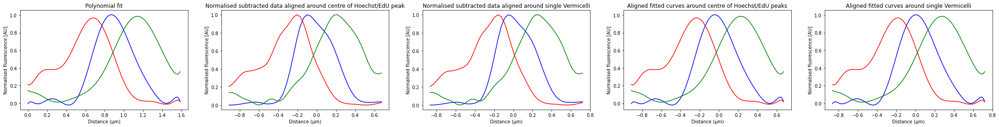

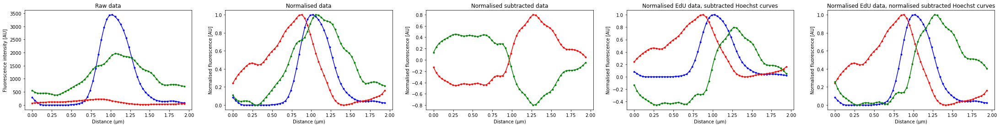

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
57    0.430889
58    0.544687
59    0.540667
60    0.464586
61    0.470061
Length: 62, dtype: float64


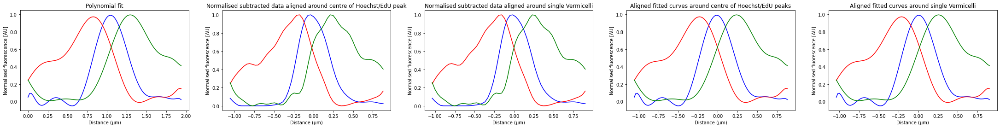

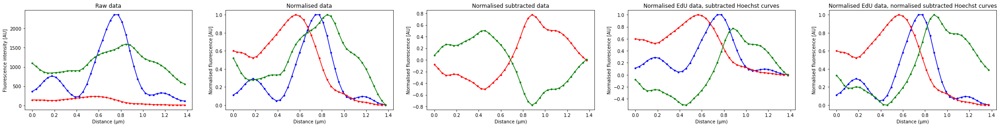

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
57    0.430889
58    0.544687
59    0.540667
60    0.464586
61    0.470061
Length: 62, dtype: float64
58.5 59
62 0.7283434343434344


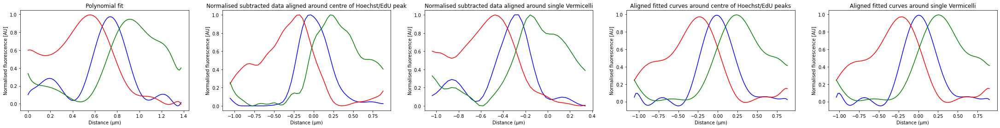

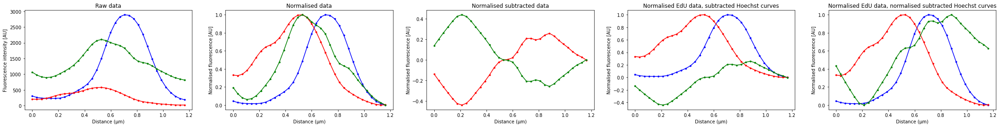

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
58    0.544687
59    0.540667
60    0.464586
61    0.470061
62    0.317182
Length: 63, dtype: float64
56.5 57
54 0.6921818181818181


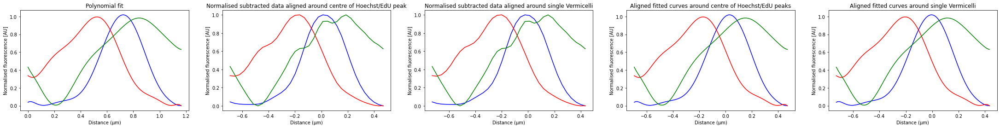

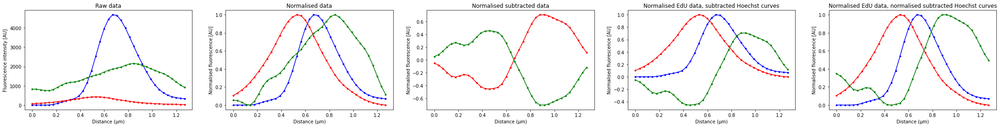

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
59    0.540667
60    0.464586
61    0.470061
62    0.317182
63    0.397364
Length: 64, dtype: float64
61.5 62
60 0.769090909090909


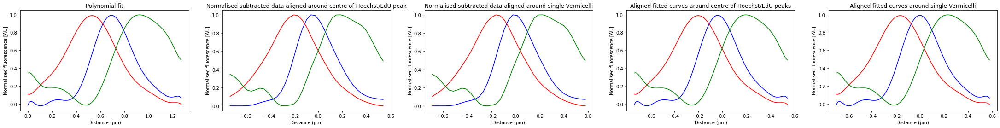

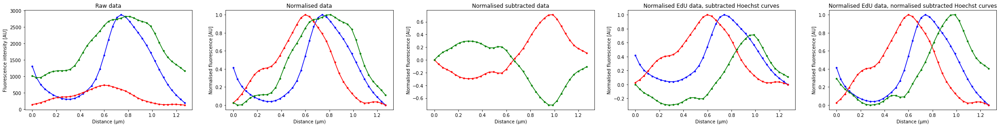

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
60    0.464586
61    0.470061
62    0.317182
63    0.397364
64    0.346091
Length: 65, dtype: float64
67.0 67
63 0.7400909090909091


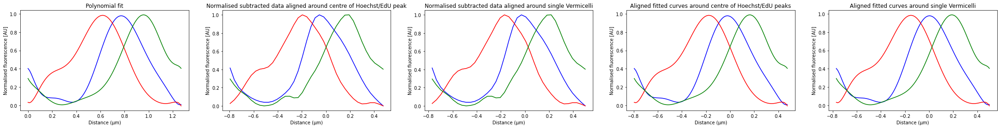

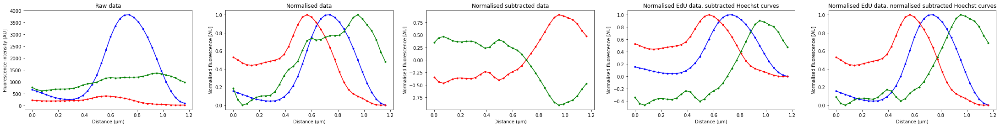

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
61    0.470061
62    0.317182
63    0.397364
64    0.346091
65    0.399414
Length: 66, dtype: float64
66.0 66
64 0.8888888888888888


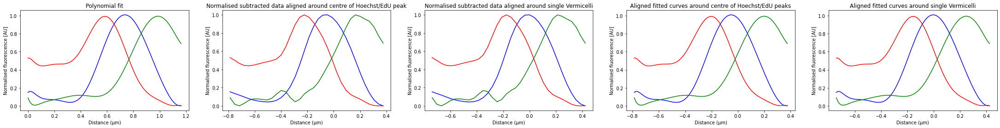

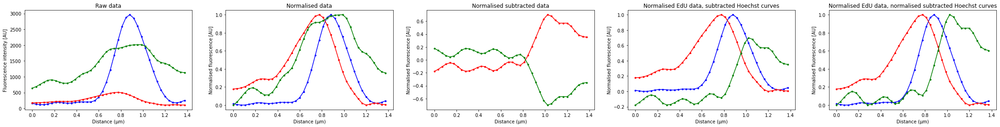

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
62    0.317182
63    0.397364
64    0.346091
65    0.399414
66    0.333333
Length: 67, dtype: float64
63.5 64
60 0.7903030303030304


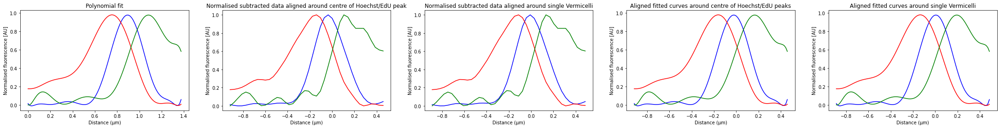

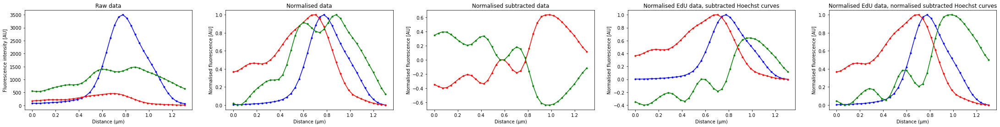

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
63    0.397364
64    0.346091
65    0.399414
66    0.333333
67    0.355636
Length: 68, dtype: float64
58.5 59
54 1.1154545454545453


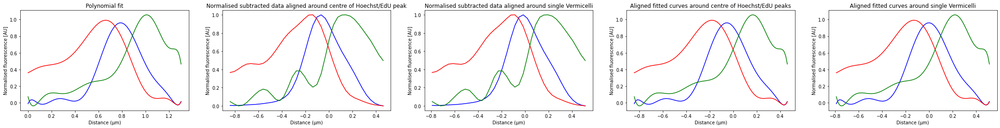

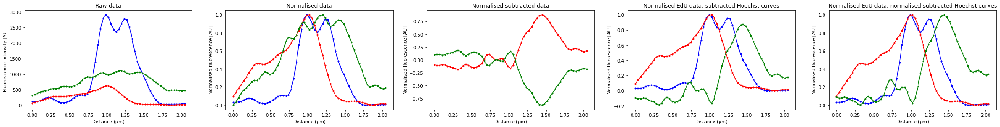

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
64    0.346091
65    0.399414
66    0.333333
67    0.355636
68    0.475101
Length: 69, dtype: float64
48.0 48
45 0.7531818181818182


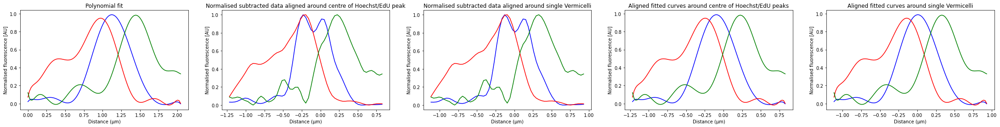

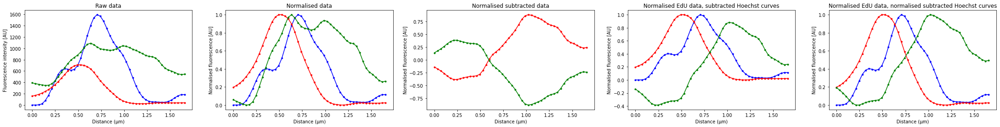

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
65    0.399414
66    0.333333
67    0.355636
68    0.475101
69    0.569071
Length: 70, dtype: float64
54.0 54
55 0.94


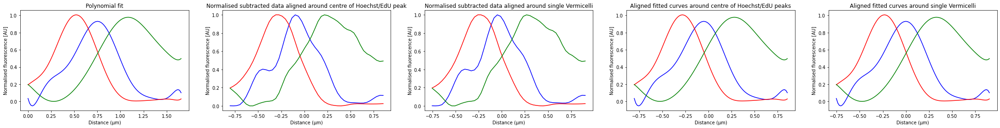

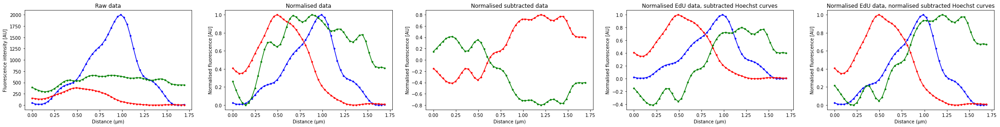

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
66    0.333333
67    0.355636
68    0.475101
69    0.569071
70    0.786182
Length: 71, dtype: float64


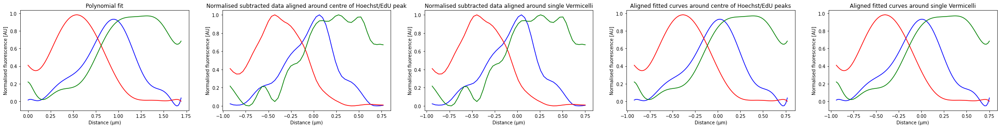

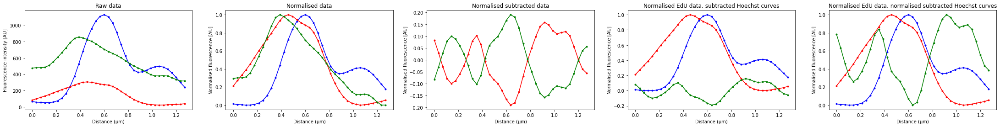

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
66    0.333333
67    0.355636
68    0.475101
69    0.569071
70    0.786182
Length: 71, dtype: float64
57.5 58
42 0.613030303030303


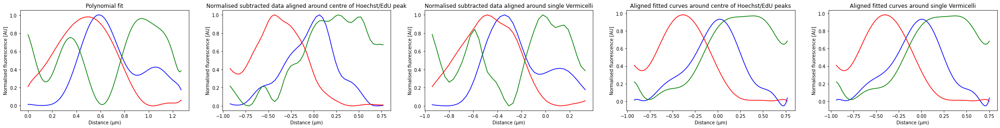

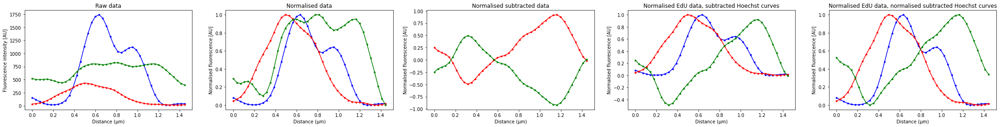

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
67    0.355636
68    0.475101
69    0.569071
70    0.786182
71    0.598434
Length: 72, dtype: float64
61.0 61
64 0.7977373737373737


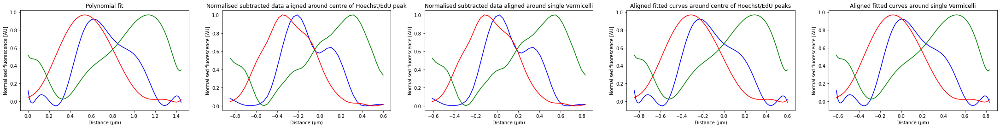

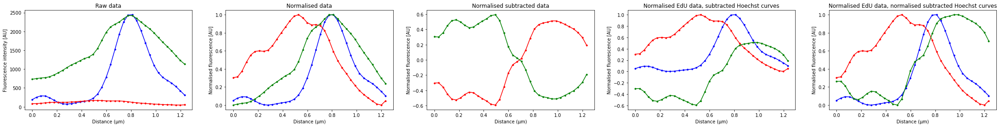

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
68    0.475101
69    0.569071
70    0.786182
71    0.598434
72    0.423798
Length: 73, dtype: float64
52.0 52
55 0.8422222222222222


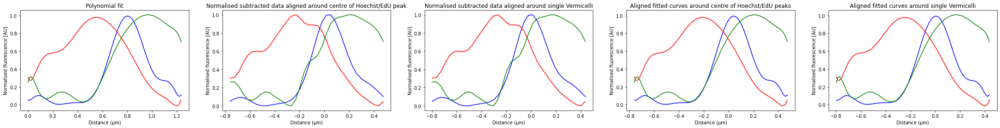

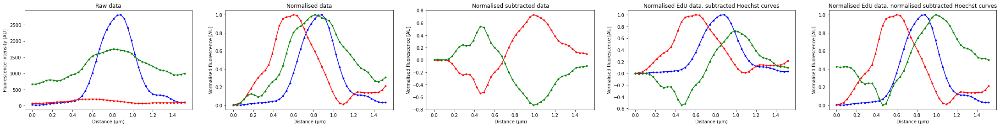

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
69    0.569071
70    0.786182
71    0.598434
72    0.423798
73    0.398141
Length: 74, dtype: float64


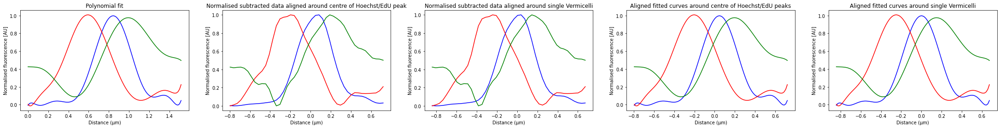

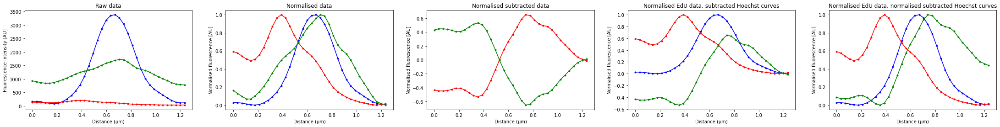

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
69    0.569071
70    0.786182
71    0.598434
72    0.423798
73    0.398141
Length: 74, dtype: float64
58.5 59
55 0.6855555555555556


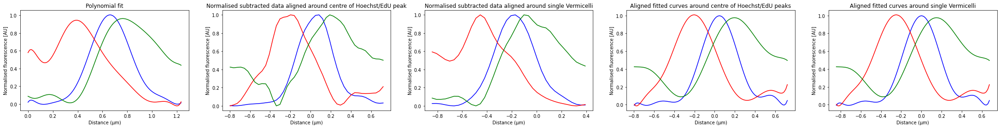

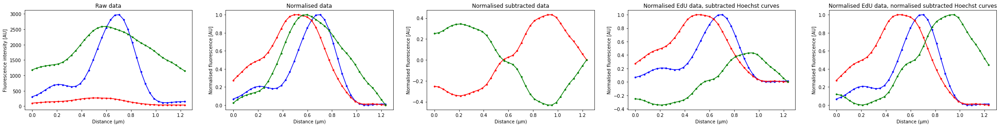

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
70    0.786182
71    0.598434
72    0.423798
73    0.398141
74    0.386404
Length: 75, dtype: float64


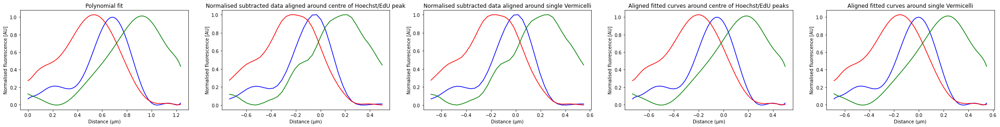

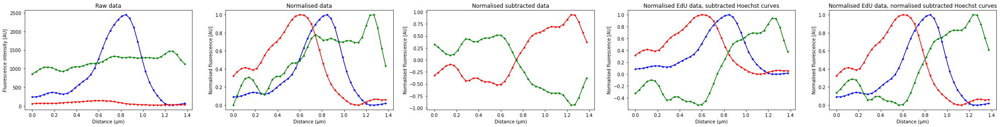

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
70    0.786182
71    0.598434
72    0.423798
73    0.398141
74    0.386404
Length: 75, dtype: float64
57.0 57
53 0.6793636363636363


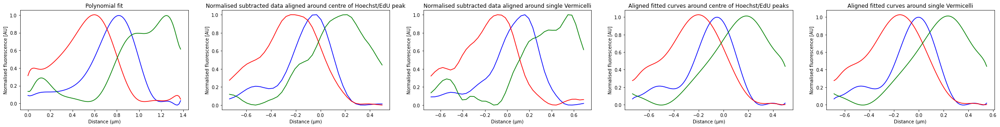

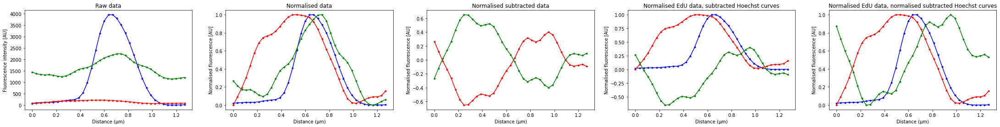

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
71    0.598434
72    0.423798
73    0.398141
74    0.386404
75    0.333273
Length: 76, dtype: float64
54.0 54
57 0.831969696969697


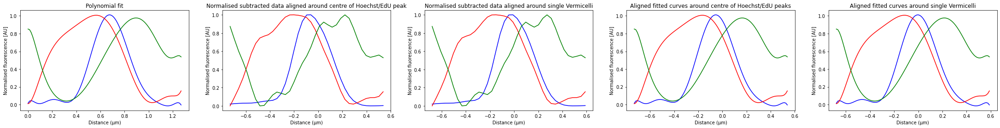

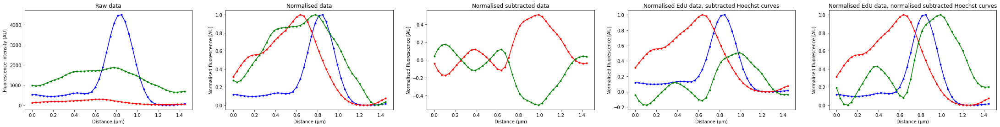

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
72    0.423798
73    0.398141
74    0.386404
75    0.333273
76    0.350303
Length: 77, dtype: float64
60.0 60
57 0.7916666666666666


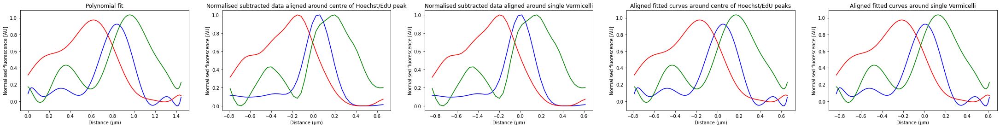

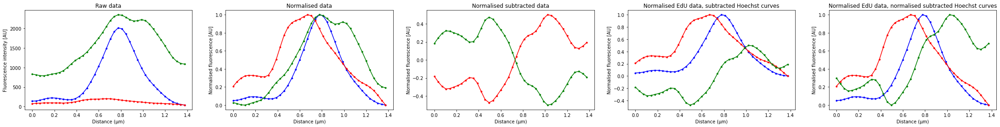

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
73    0.398141
74    0.386404
75    0.333273
76    0.350303
77    0.416667
Length: 78, dtype: float64


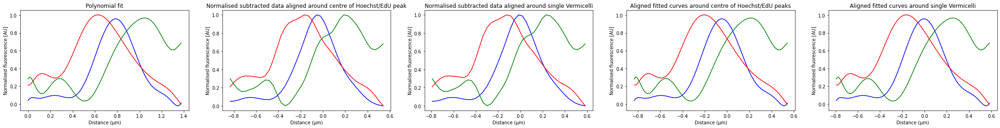

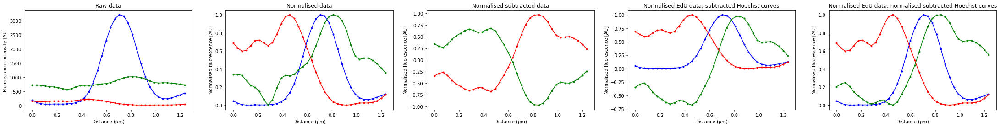

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
73    0.398141
74    0.386404
75    0.333273
76    0.350303
77    0.416667
Length: 78, dtype: float64
54.0 54
55 0.705


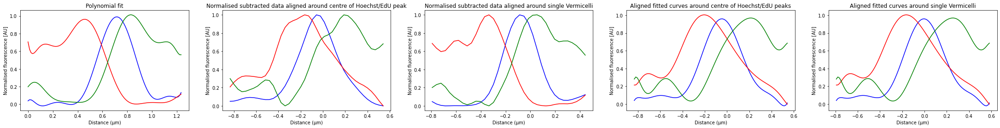

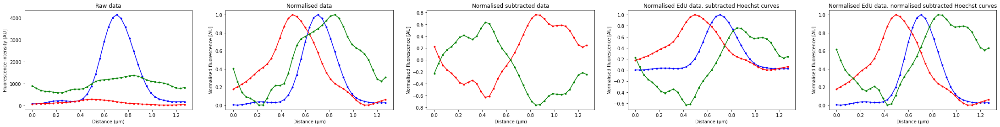

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
74    0.386404
75    0.333273
76    0.350303
77    0.416667
78    0.358909
Length: 79, dtype: float64
52.0 52
52 0.5924848484848484


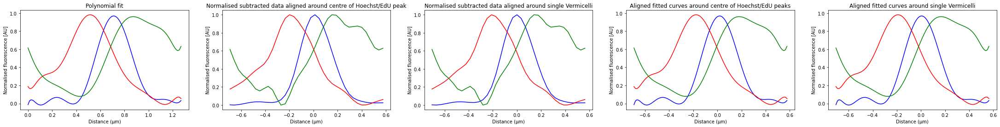

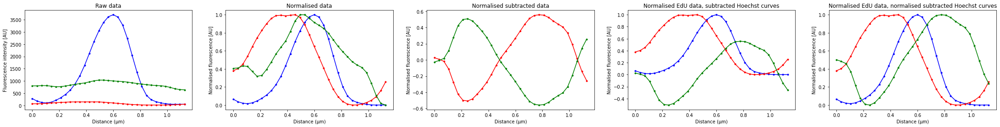

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
75    0.333273
76    0.350303
77    0.416667
78    0.358909
79    0.387394
Length: 80, dtype: float64


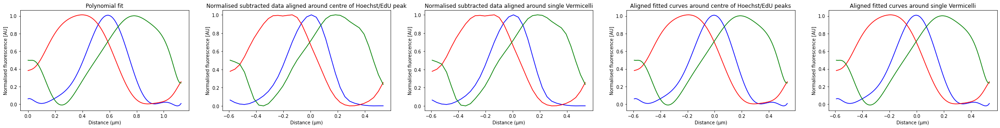

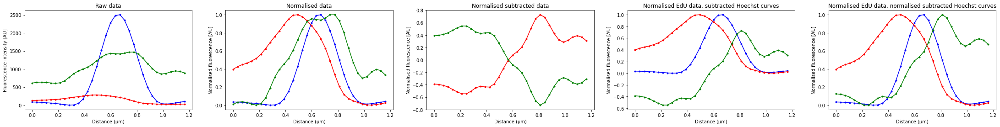

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
75    0.333273
76    0.350303
77    0.416667
78    0.358909
79    0.387394
Length: 80, dtype: float64
69.5 70
55 0.6855555555555556


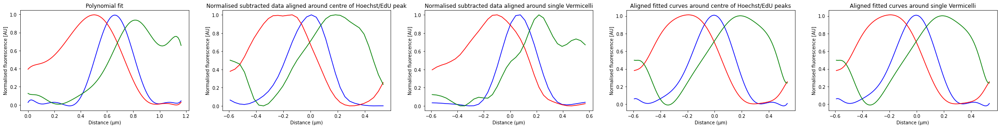

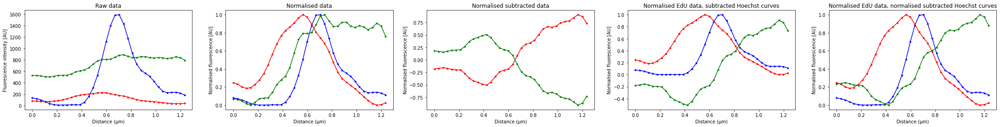

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
76    0.350303
77    0.416667
78    0.358909
79    0.387394
80    0.635697
Length: 81, dtype: float64
58.5 59
56 0.8971313131313132


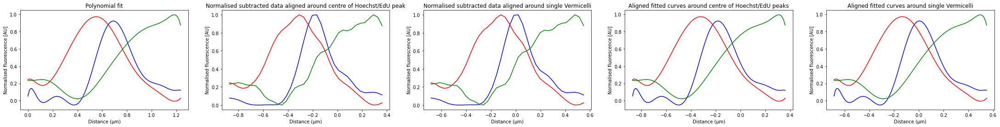

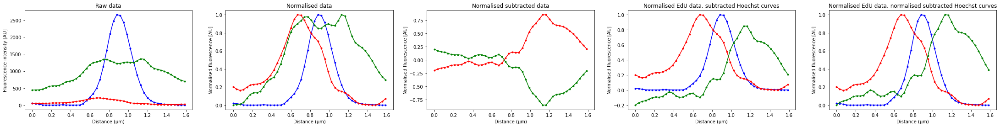

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
77    0.416667
78    0.358909
79    0.387394
80    0.635697
81    0.464586
Length: 82, dtype: float64
53.0 53
46 0.7536565656565658


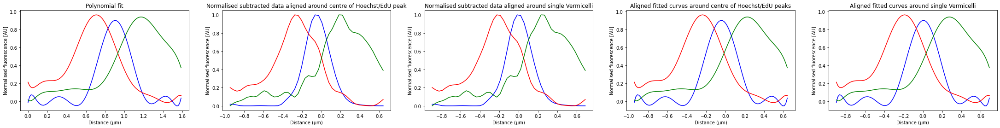

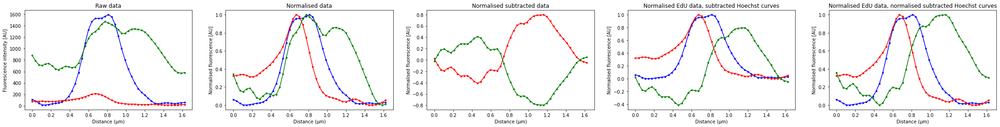

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
78    0.358909
79    0.387394
80    0.635697
81    0.464586
82    0.425980
Length: 83, dtype: float64
49.0 49
52 0.77789898989899


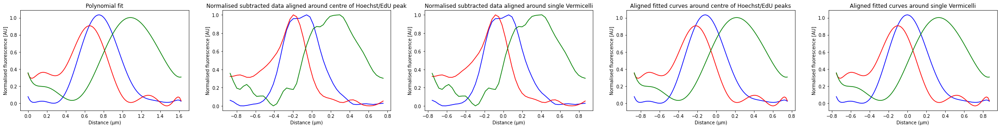

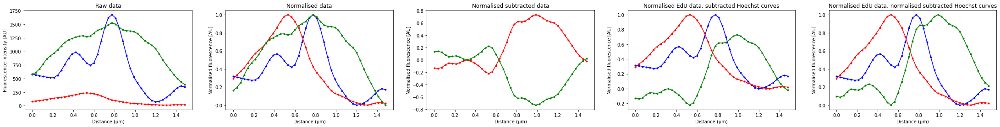

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
79    0.387394
80    0.635697
81    0.464586
82    0.425980
83    0.418869
Length: 84, dtype: float64
67.0 67
67 0.977929292929293


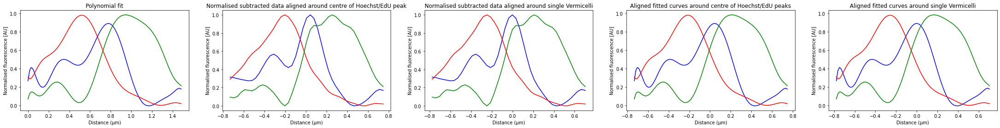

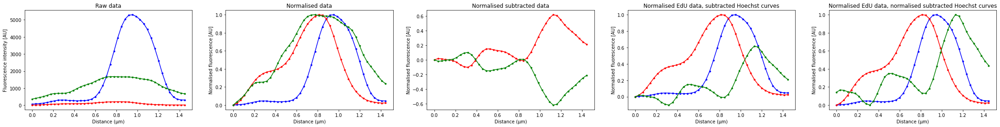

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
80    0.635697
81    0.464586
82    0.425980
83    0.418869
84    0.350303
Length: 85, dtype: float64


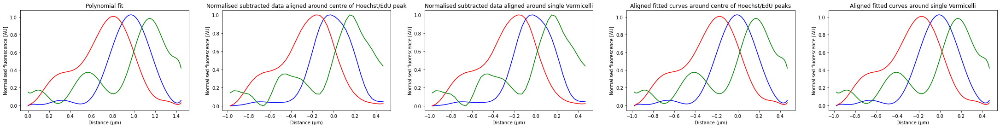

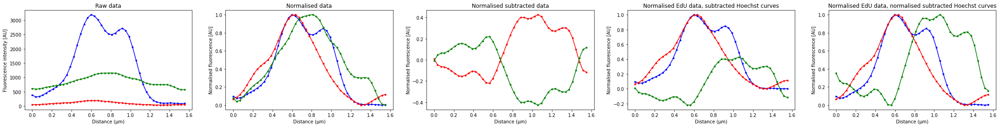

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
80    0.635697
81    0.464586
82    0.425980
83    0.418869
84    0.350303
Length: 85, dtype: float64
60.0 60
61 0.8472222222222222


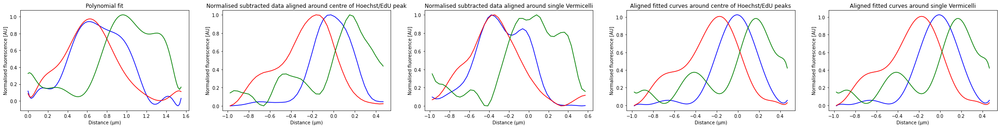

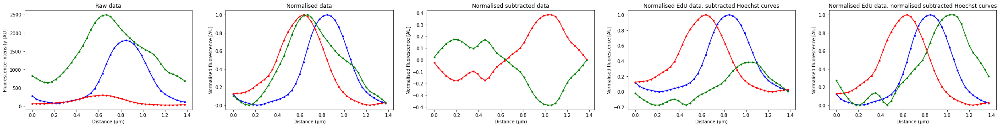

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
81    0.464586
82    0.425980
83    0.418869
84    0.350303
85    0.416667
Length: 86, dtype: float64
60.5 61
57 0.8929999999999999


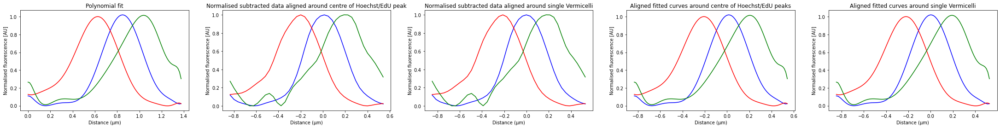

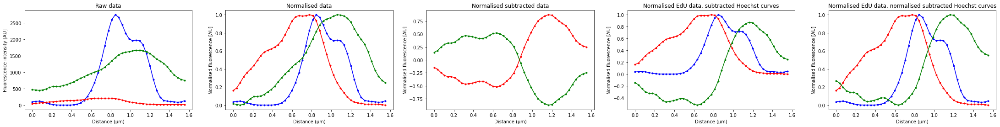

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
82    0.425980
83    0.418869
84    0.350303
85    0.416667
86    0.423000
Length: 87, dtype: float64


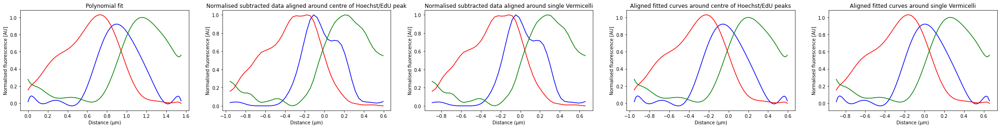

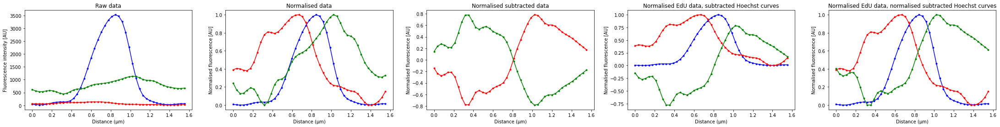

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
82    0.425980
83    0.418869
84    0.350303
85    0.416667
86    0.423000
Length: 87, dtype: float64
49.0 49
56 0.698020202020202


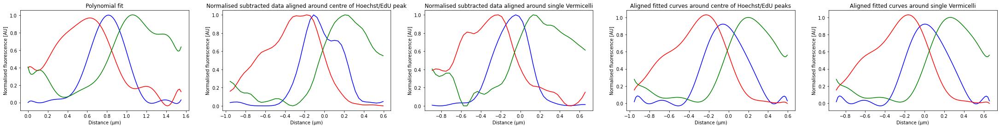

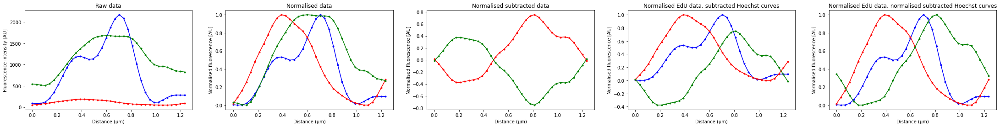

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
83    0.418869
84    0.350303
85    0.416667
86    0.423000
87    0.373939
Length: 88, dtype: float64
68.0 68
60 0.6624242424242424


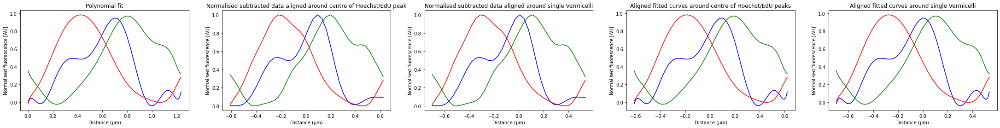

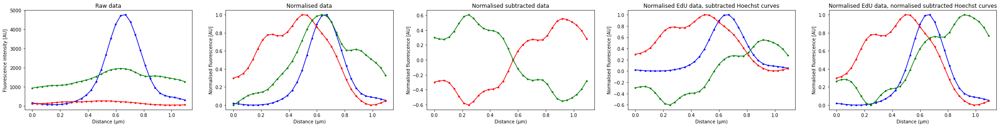

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
84    0.350303
85    0.416667
86    0.423000
87    0.373939
88    0.441616
Length: 89, dtype: float64
55.0 55
48 0.5813333333333334


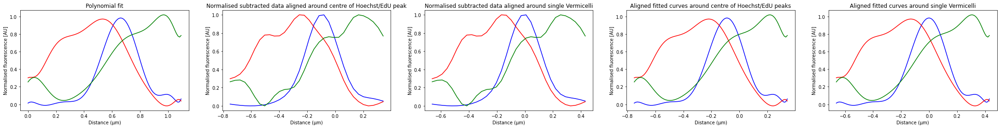

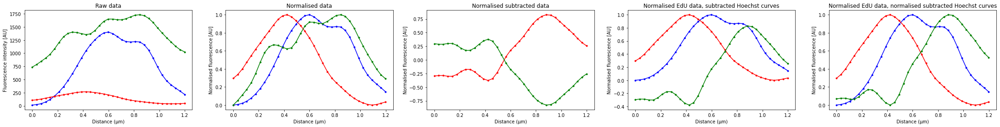

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
85    0.416667
86    0.423000
87    0.373939
88    0.441616
89    0.484444
Length: 90, dtype: float64
56.5 57
55 0.7244444444444446


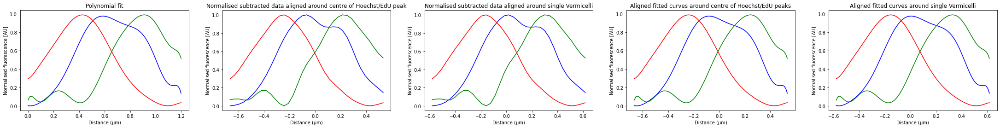

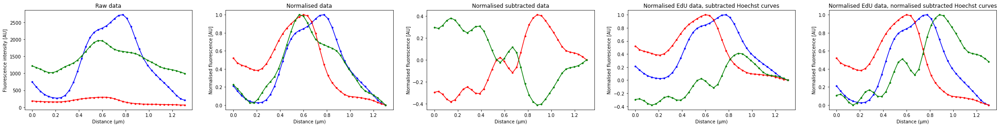

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
86    0.423000
87    0.373939
88    0.441616
89    0.484444
90    0.355636
Length: 91, dtype: float64
52.0 52
41 0.5400404040404041


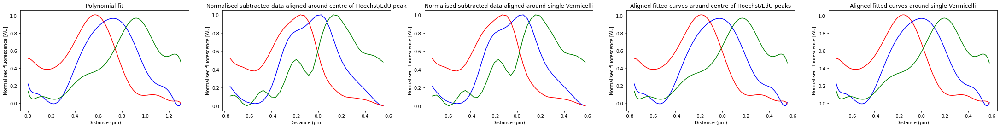

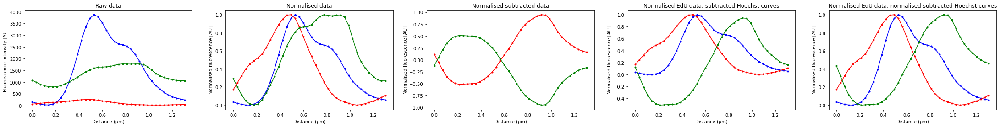

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
87    0.373939
88    0.441616
89    0.484444
90    0.355636
91    0.421495
Length: 92, dtype: float64
49.0 49
53 0.641888888888889


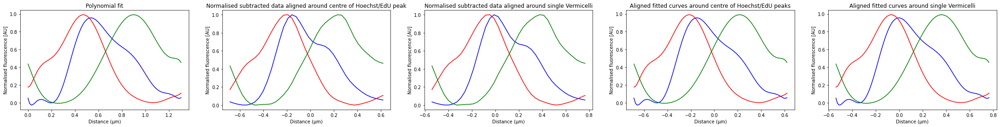

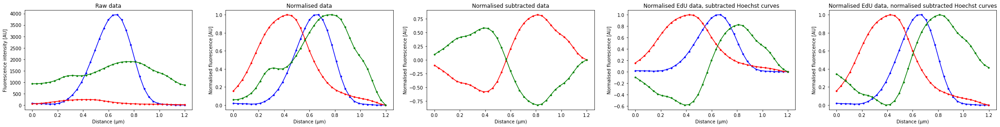

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
88    0.441616
89    0.484444
90    0.355636
91    0.421495
92    0.387556
Length: 93, dtype: float64
59.5 60
59 0.8403030303030303


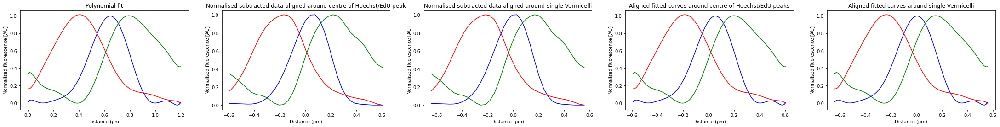

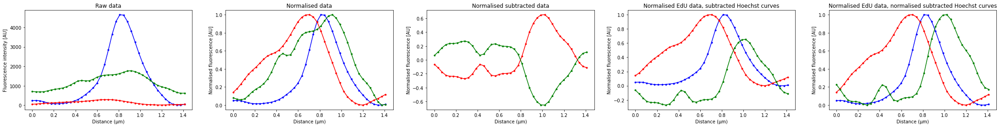

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
89    0.484444
90    0.355636
91    0.421495
92    0.387556
93    0.327576
Length: 94, dtype: float64
56.5 57
53 0.736111111111111


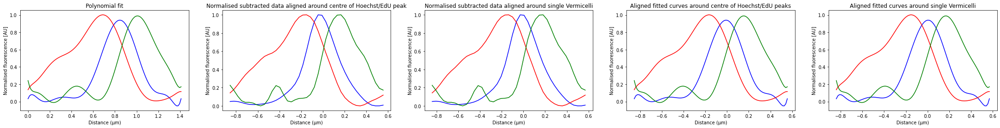

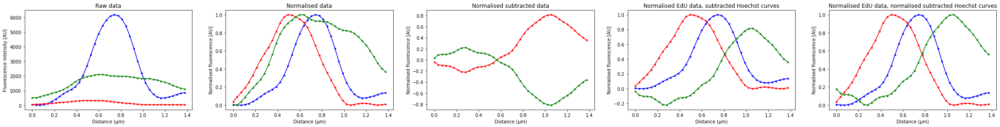

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
90    0.355636
91    0.421495
92    0.387556
93    0.327576
94    0.486111
Length: 95, dtype: float64


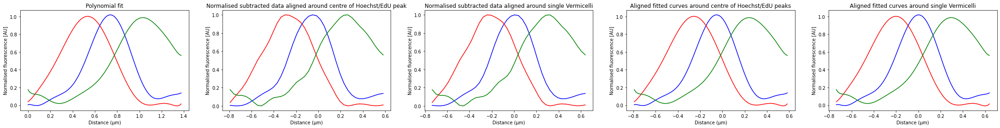

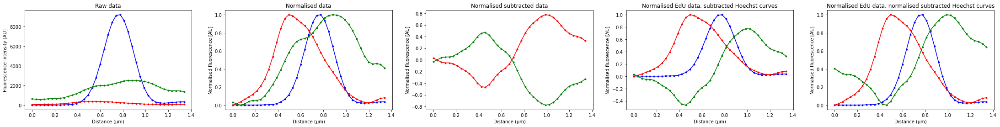

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
90    0.355636
91    0.421495
92    0.387556
93    0.327576
94    0.486111
Length: 95, dtype: float64
53.5 54
48 0.6152727272727272


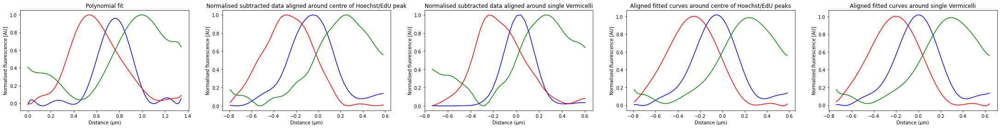

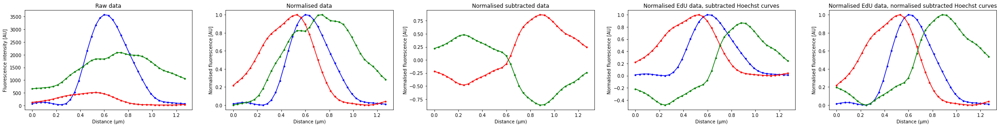

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
91    0.421495
92    0.387556
93    0.327576
94    0.486111
95    0.371727
Length: 96, dtype: float64
56.0 56
49 0.784989898989899


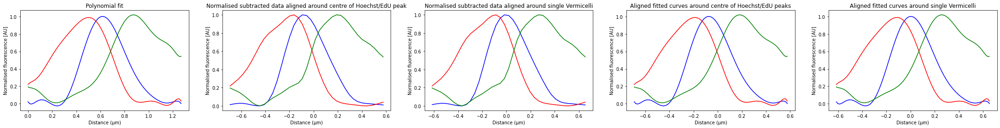

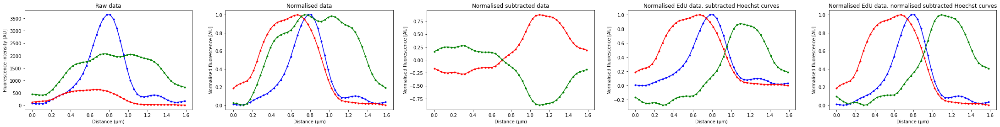

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
92    0.387556
93    0.327576
94    0.486111
95    0.371727
96    0.512646
Length: 97, dtype: float64


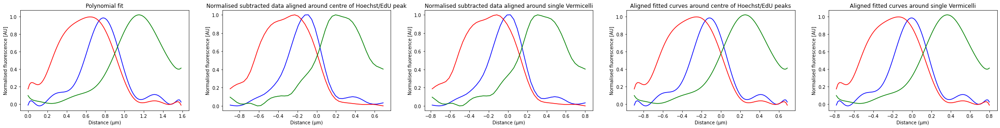

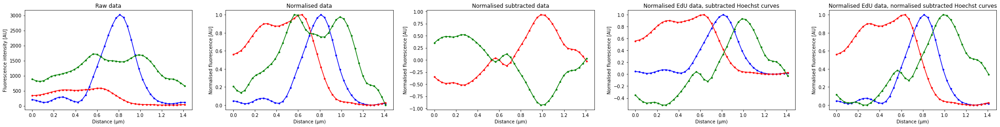

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
92    0.387556
93    0.327576
94    0.486111
95    0.371727
96    0.512646
Length: 97, dtype: float64
52.5 53
54 0.8269090909090909


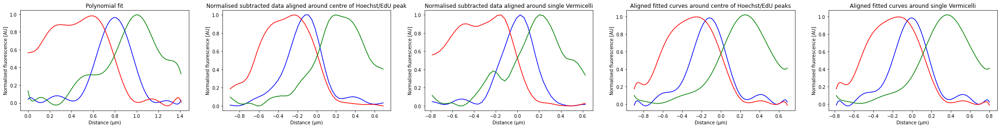

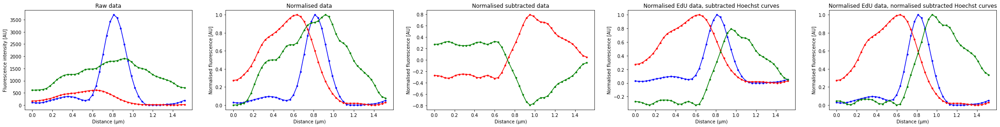

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
93    0.327576
94    0.486111
95    0.371727
96    0.512646
97    0.382828
Length: 98, dtype: float64
55.0 55
47 0.752949494949495


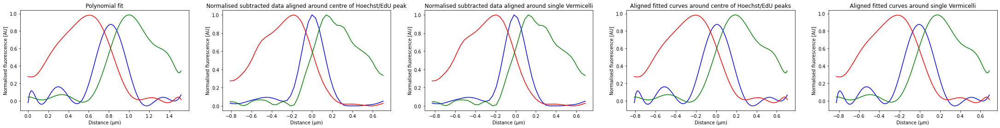

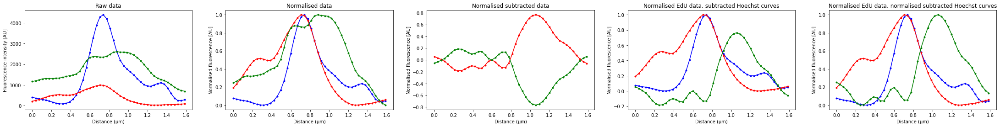

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
94    0.486111
95    0.371727
96    0.512646
97    0.382828
98    0.352444
Length: 99, dtype: float64
63.0 63
61 0.9994141414141415


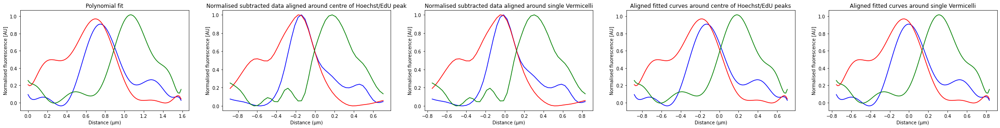

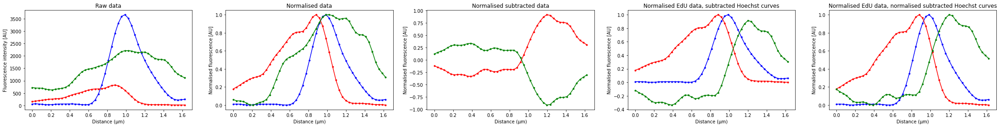

0     0.394091
1     0.351919
2     0.327000
3     0.441515
4     0.351919
        ...   
95    0.371727
96    0.512646
97    0.382828
98    0.352444
99    0.425980
Length: 100, dtype: float64
61.5 62
62 0.861111111111111


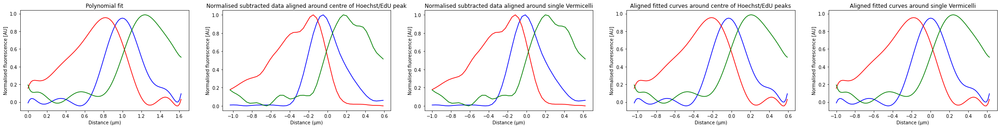

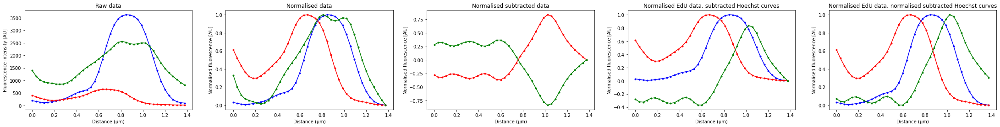

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
96     0.512646
97     0.382828
98     0.352444
99     0.425980
100    0.347222
Length: 101, dtype: float64
50.5 51
51 0.7263636363636363


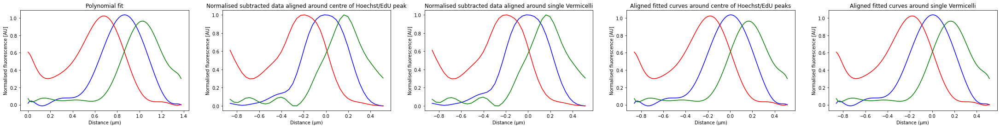

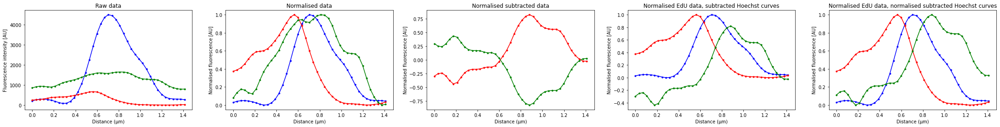

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
97     0.382828
98     0.352444
99     0.425980
100    0.347222
101    0.356061
Length: 102, dtype: float64
57.5 58
53 0.736111111111111


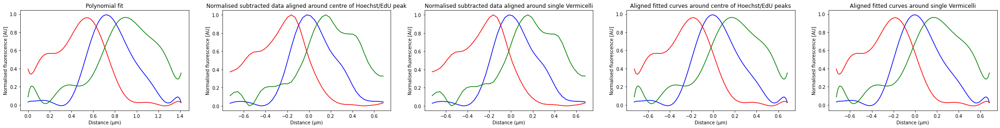

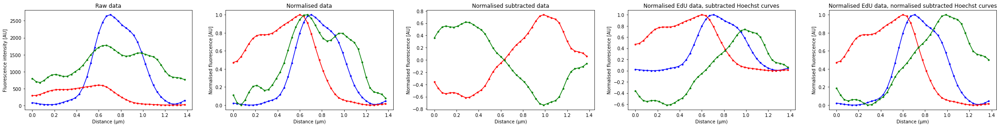

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
98     0.352444
99     0.425980
100    0.347222
101    0.356061
102    0.458333
Length: 103, dtype: float64
60.0 60
60 0.9830303030303031


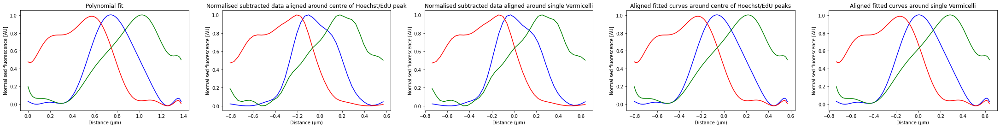

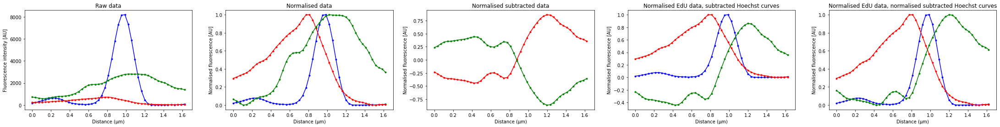

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
99     0.425980
100    0.347222
101    0.356061
102    0.458333
103    0.425980
Length: 104, dtype: float64
51.5 52
44 0.5013333333333333


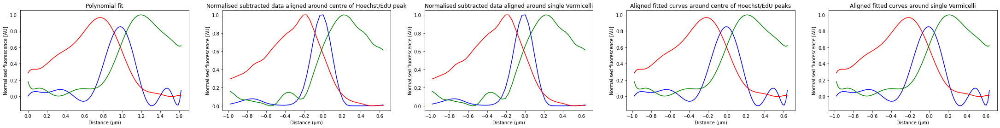

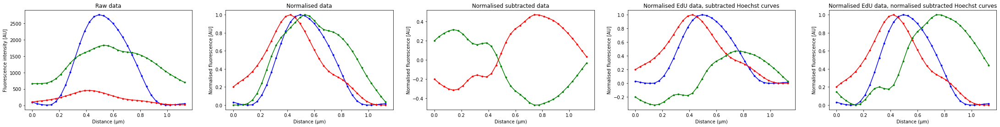

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
100    0.347222
101    0.356061
102    0.458333
103    0.425980
104    0.330424
Length: 105, dtype: float64
56.0 56
43 0.6432626262626263


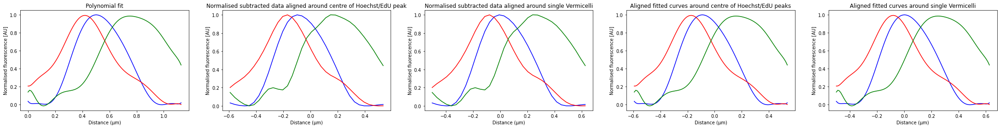

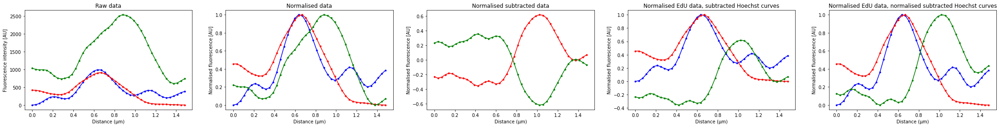

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
101    0.356061
102    0.458333
103    0.425980
104    0.330424
105    0.359030
Length: 106, dtype: float64
62.5 63
53 0.8490707070707071


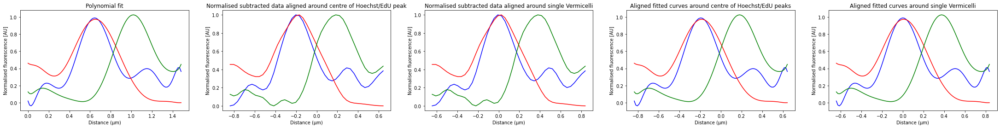

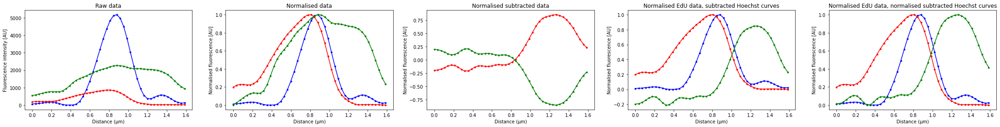

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
102    0.458333
103    0.425980
104    0.330424
105    0.359030
106    0.464586
Length: 107, dtype: float64


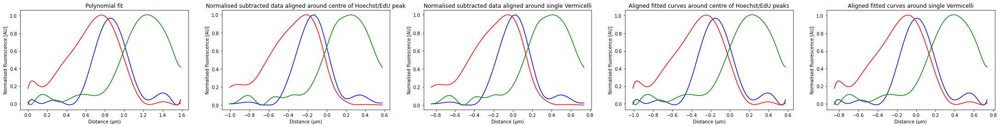

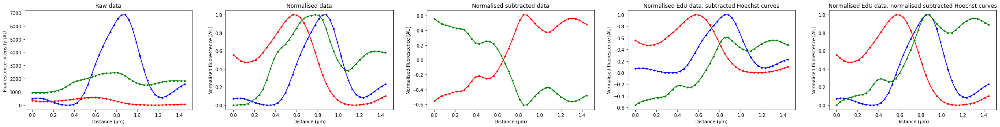

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
102    0.458333
103    0.425980
104    0.330424
105    0.359030
106    0.464586
Length: 107, dtype: float64
66.0 66
64 1.0026666666666666


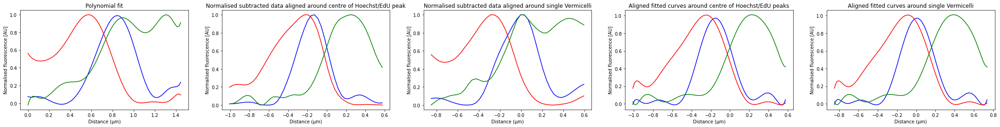

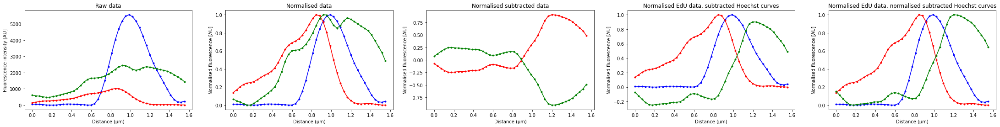

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
103    0.425980
104    0.330424
105    0.359030
106    0.464586
107    0.438667
Length: 108, dtype: float64
56.5 57
60 0.8975757575757577


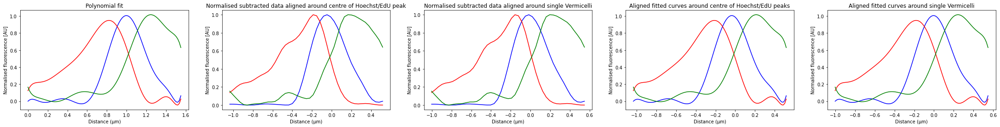

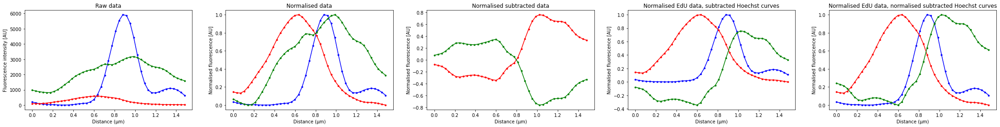

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
104    0.330424
105    0.359030
106    0.464586
107    0.438667
108    0.433828
Length: 109, dtype: float64
59.0 59
62 0.9494141414141414


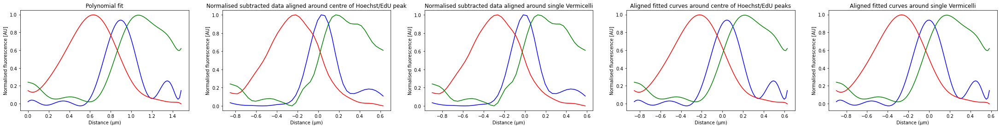

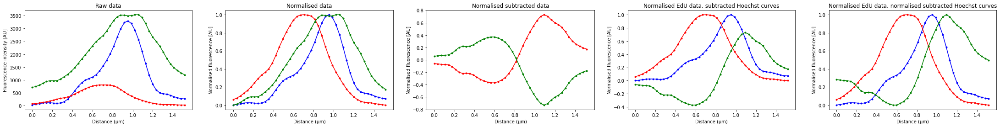

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
105    0.359030
106    0.464586
107    0.438667
108    0.433828
109    0.398141
Length: 110, dtype: float64


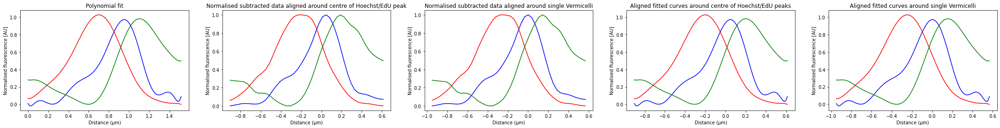

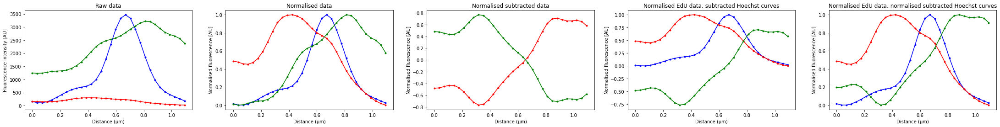

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
105    0.359030
106    0.464586
107    0.438667
108    0.433828
109    0.398141
Length: 110, dtype: float64


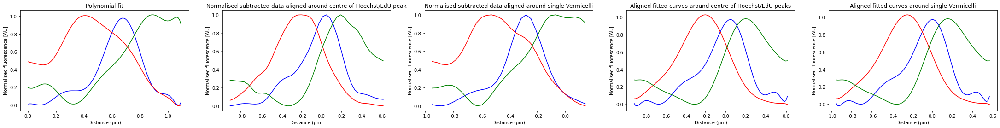

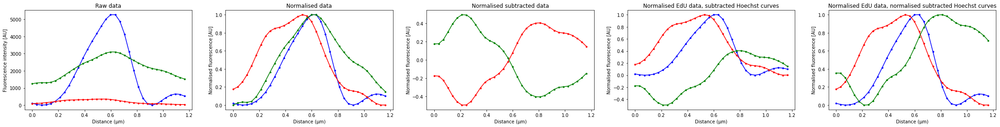

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
105    0.359030
106    0.464586
107    0.438667
108    0.433828
109    0.398141
Length: 110, dtype: float64


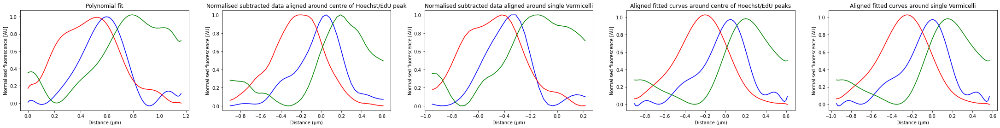

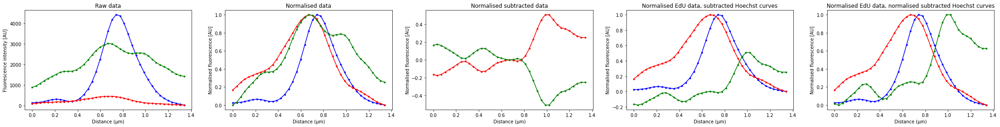

0      0.394091
1      0.351919
2      0.327000
3      0.441515
4      0.351919
         ...   
105    0.359030
106    0.464586
107    0.438667
108    0.433828
109    0.398141
Length: 110, dtype: float64


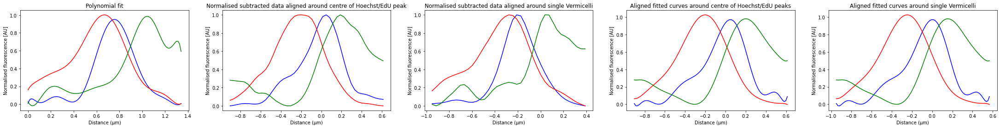

In [7]:
# read in files
path = "/groups/gerlich/experiments/Experiments_005500/005556/wapl_dep/lineprofiles3/"

csv_files = glob.glob(path + "*/*.csv")
### Fetch all files in path

#head, tail = os.path.split(path_lateprophase)
#set condition
condition = "Wapl depleted G2"

#set up empty lists to append
name = []
#scc1 channel
peaks1_scc1 = []
peaks2_scc1 = []
peaks1_value_scc1 = []
peaks2_value_scc1 = []

#edu channel
peaks1_edu = []
peaks1_value_edu = []

#hoechst channel
peaks1_hoechst = []
peaks1_value_hoechst = []

distance_scc1_peaks_all = []
distance_edu_peaks_all = []
distance_hoechst_peaks_all = []

all_displacement_edu_scc1 = []
all_displacement_hoechst_scc1 = []
all_displacement_scc1_edu = []


for file in csv_files:
    split = file.split(os.sep)
    image_name = split[-2]
    #read in line profiles
    df = pd.read_csv(file, index_col = 0)
       
    #rename columns
    df.columns = ['Distance', 'scc1', 'edu', 'hoechst']
    
    #set distance to variable
    distance = df.loc[:, "Distance"]
   
    #deep copy and then min/max normalisation
    df2 = df.copy()
    for column in df2.columns:
        df2[column] = (df2[column] - df2[column].min()) / (df2[column].max() - df2[column].min())   
        
        df2["Distance"] = distance     

    #subtract edu values from hoechst values

    if np.where(df2['edu']>= df2["hoechst"]):
        df2["hoechst_minus_edu"] = (df2['hoechst'] - df2["edu"])
    
    #subtract hoechst values from edu values
    if np.where(df2['hoechst']>= df2["edu"]):
        df2["edu_minus_hoechst"] = (df2['edu'] - df2["hoechst"])

    #normalisation of subtracted data
    df3 = df2.copy()
    
    df3["hoechst_minus_edu"] = (df3["hoechst_minus_edu"] - df3["hoechst_minus_edu"].min()) / (df3["hoechst_minus_edu"].max() - df3["hoechst_minus_edu"].min())
    df3.rename(columns = {'hoechst_minus_edu':'hoechst_minus_edu_norm'}, inplace = True)

    df3["Distance"] = distance
  
    #drop NaN values
    df3 = df3.dropna(axis=0)
    
    #set results directory
    resultsdir_plotprofiles = "/groups/gerlich/experiments/Experiments_005500/005556/csv_files_plot_profiles/"
    
    #df3.to_csv(resultsdir_plotprofiles + "wapl_sororin_depleted_g2.csv", index=False)
    
    
    #fit the data using polynomial fit
    #scc1 channel
    p = np.poly1d(np.polyfit(df3["Distance"],df3["scc1"], 10))
    #edu channel
    q = np.poly1d(np.polyfit(df3["Distance"],df3["edu"], 10))
    #normalised hoechst channel
    r = np.poly1d(np.polyfit(df3["Distance"],df3["hoechst_minus_edu_norm"], 10))
    #x-axis values
    
    #find peaks
    t = np.linspace(0,max(df3["Distance"]), 100)
    peaks_scc1, heights_scc1 = signal.find_peaks(p(t),max(df3["scc1"])*0.6)
    peaks_edu, heights_edu = signal.find_peaks(q(t),max(df3["edu"])*0.6)
    peaks_hoechst, heights_hoechst = signal.find_peaks(r(t),max(df3["hoechst_minus_edu_norm"])*0.6)


    #only consider instances where a single peak has been detected for the three channels
    #find the index with the maximum peak value
    #index_max_height_scc1 = np.argmax(heights_scc1)
    #index_max_height_edu = np.argmax(heights_edu)
    #index_max_height_hoechst = np.argmax(heights_hoechst)
    #only select when there is a single peak for edu and hoechst and a single peak for scc1
    
    if len (peaks_scc1) == 1 and len(peaks_edu) == 1 and len(peaks_hoechst) == 1:
        #slice t, using index of the channel peak to get the distance value for the three channels 
        distance_scc1_peak = t[peaks_scc1]
        distance_edu_peak = t[peaks_edu]
        distance_hoechst_peak = t[peaks_hoechst]
        
        displacement_scc1_edu = (t[peaks_scc1]) - (t[peaks_edu])
        displacement_hoechst_scc1 = (t[peaks_hoechst]) - (t[peaks_scc1])   
        displacement_edu_scc1 = (t[peaks_edu]) - (t[peaks_scc1])      
        
        
        #append each line profile to each list for the three channels
        peaks1_scc1.append(peaks_scc1[0])
        #peaks2_scc1.append(peaks_scc1[1])
        peaks1_value_scc1.append(heights_scc1['peak_heights'][0])
        distance_scc1_peaks_all.append(distance_scc1_peak[0])

        peaks1_edu.append(peaks_edu[0])
        #peaks2_scc1.append(peaks_scc1[1])
        peaks1_value_edu.append(heights_edu['peak_heights'][0])
        distance_edu_peaks_all.append(distance_edu_peak[0])

        peaks1_hoechst.append(peaks_hoechst[0])
        #peaks2_scc1.append(peaks_scc1[1])
        peaks1_value_hoechst.append(heights_hoechst['peak_heights'][0])
        distance_hoechst_peaks_all.append(distance_hoechst_peak[0])
        
        all_displacement_scc1_edu.append(displacement_scc1_edu[0])
        all_displacement_hoechst_scc1.append(displacement_hoechst_scc1[0])
        all_displacement_edu_scc1.append(displacement_edu_scc1[0])
        
        centre_index = list(map(get_index, peaks1_edu, peaks1_hoechst))
                        
        for i in centre_index:
            values = float(i)
            if values % 1 < 0.5:
                centre = math.floor(values)
            else:
                centre = math.ceil(values)
                        
        norm = t[centre]
        #all_norm.append(norm)
        print(values, centre)

        x_align_dna = (t-norm)
        y1_align_dna = p(t)
        y2_align_dna = q(t)
        y3_align_dna = r(t)
        
        x_norm_aligned_dna = ((df2 ["Distance"])-norm)
        y1_norm_aligned_dna = ((df2["scc1"]))
        y2_norm_aligned_dna = ((df2["edu"]))
        y3_norm_aligned_dna = ((df3["hoechst_minus_edu_norm"]))       
               
        centre_index_single_axis = list(map(get_index_single_axis, peaks_scc1))

        for i in centre_index_single_axis:
            centre_axis = int(i)
            centre_axis
        norm_axis = t[centre_axis]
        print(centre_axis, norm_axis)
            
        x_align_axis = (t-norm_axis)
        y1_align_axis = p(t)
        y2_align_axis = q(t)
        y3_align_axis = r(t)
        
        x_norm_aligned_axis = ((df2 ["Distance"])-norm_axis)
        y1_norm_aligned_axis = ((df2["scc1"]))
        y2_norm_aligned_axis = ((df2["edu"]))
        y3_norm_aligned_axis = ((df3["hoechst_minus_edu_norm"]))       
        
        #append image name
        name.append(image_name)          

    #plot raw data, normalised data, subtracted data
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize = (38,4))
      
    
    #plot raw data
    x_raw = df["Distance"]
    y1_raw = df["scc1"]
    y2_raw = df["edu"]
    y3_raw = df["hoechst"]
            
    ax1.plot(x_raw, y1_raw, c='b', marker = '.', label='scc1')
    ax1.plot(x_raw, y2_raw, c='r', marker = '.', label='edu')
    ax1.plot(x_raw, y3_raw, c='g', marker = '.', label='hoechst')  
    #plt.xlim([0, 1.6])
    
    #plot normalised data - min/max normalisation
    x_norm = df2 ["Distance"]
    y1_norm = df2["scc1"]
    y2_norm = df2["edu"]
    y3_norm = df2["hoechst"]
       
    ax2.plot(x_norm,y1_norm, c='b', marker = '.', label='scc1')
    ax2.plot(x_norm, y2_norm, c='r', marker = '.', label='edu')
    ax2.plot(x_norm, y3_norm, c='g', marker = '.', label='hoechst')
    
    
    #plot subtracted curves - edu minus hoechst, hoechst minus edu
    x_subtract = df2["Distance"]
    y1_subtract = df2["hoechst_minus_edu"]
    y2_subtract = df2["edu_minus_hoechst"]
    
    ax3.plot(x_subtract, y1_subtract, c='r', marker = '.', label='edu')
    ax3.plot(x_subtract, y2_subtract, c='g', marker = '.', label='hoechst')
    
    ax4.plot(x_norm, y1_norm, c='b', marker = '.', label='scc1')
    ax4.plot(x_norm, y2_norm, c='r', marker = '.', label='edu')
    ax4.plot(x_norm, y1_subtract, c='g', marker = '.', label='hoechst')
    
    y1_renorm = df3["hoechst_minus_edu_norm"]
    
    ax5.plot(x_norm, y1_norm, c='b', marker = '.', label='scc1')
    ax5.plot(x_norm, y2_norm, c='r', marker = '.', label='edu')
    ax5.plot(x_norm, y1_renorm, c='g', marker = '.', label='hoechst')
    
    # set axis labels
    ax1.set_xlabel('Distance (µm)')
    ax1.set_ylabel('Fluorescence intensity [AU]')
    ax2.set_xlabel('Distance (µm)')
    ax2.set_ylabel('Normalised fluorescence [AU]')
    ax3.set_xlabel('Distance (µm)')
    ax3.set_ylabel('Normalised fluorescence [AU]')
    ax4.set_xlabel('Distance (µm)')
    ax4.set_ylabel('Normalised fluorescence [AU]')
    ax5.set_xlabel('Distance (µm)')
    ax5.set_ylabel('Normalised fluorescence [AU]')
    
    #set plot titles
    ax1.title.set_text('Raw data')
    ax2.title.set_text('Normalised data')
    ax3.title.set_text('Normalised subtracted data')
    ax4.title.set_text('Normalised EdU data, subtracted Hoechst curves')
    ax5.title.set_text('Normalised EdU data, normalised subtracted Hoechst curves')
    
    #get conditions for labels
    labels = ["Scc1", "f-ara-EdU", "Hoechst"]
    #handles, labels = ax1.get_legend_handles_labels()
    #fig.legend(handles, labels, loc='lower center',prop={"size":16})
        
    plt.show()
    
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize = (38,4))
    #plot the data - same colour scheme as other plots below
    x_fitted = t
    y1_fitted = p(t)
    y2_fitted = q(t)
    y3_fitted = r(t)
    ax1.plot(x_fitted, y1_fitted, c='b', label='scc1')
    ax1.plot(x_fitted, y2_fitted, c='r', label='edu')
    ax1.plot(x_fitted, y3_fitted, c='g', label='hoechst')
    ax1.set_title("Polynomial fit")
    ax1.set_xlabel('Distance (µm)')
    ax1.set_ylabel('Normalised fluorescence [AU]')    
        
    ax2.plot(x_norm_aligned_dna, y1_norm_aligned_dna, c='b', label='scc1')
    ax2.plot(x_norm_aligned_dna, y2_norm_aligned_dna, c='r', label='edu')
    ax2.plot(x_norm_aligned_dna, y3_norm_aligned_dna, c='g', label='hoechst')
    ax2.set_title("Normalised subtracted data aligned around centre of Hoechst/EdU peak")
    ax2.set_xlabel('Distance (µm)')
    ax2.set_ylabel('Normalised fluorescence [AU]')
    
    x_norm_aligned_axis = ((df2 ["Distance"])-norm_axis)
    y1_norm_aligned_axis = ((df2["scc1"]))
    y2_norm_aligned_axis = ((df2["edu"]))
    y3_norm_aligned_axis = ((df3["hoechst_minus_edu_norm"])) 
    
    ax3.plot(x_norm_aligned_axis, y1_norm_aligned_axis, c='b', label='scc1')
    ax3.plot(x_norm_aligned_axis, y2_norm_aligned_axis, c='r', label='edu')
    ax3.plot(x_norm_aligned_axis, y3_norm_aligned_axis, c='g', label='hoechst')
    ax3.set_title("Normalised subtracted data aligned around single Vermicelli")
    ax3.set_xlabel('Distance (µm)')
    ax3.set_ylabel('Normalised fluorescence [AU]')
    
    
    ax4.plot(x_align_dna, y1_align_dna, c='b', label='scc1')
    ax4.plot(x_align_dna, y2_align_dna, c='r', label='edu')
    ax4.plot(x_align_dna, y3_align_dna, c='g', label='hoechst')
    ax4.set_title("Aligned fitted curves around centre of Hoechst/EdU peaks")
    ax4.set_xlabel('Distance (µm)')
    ax4.set_ylabel('Normalised fluorescence [AU]')

    ax5.plot(x_align_axis, y1_align_axis, c='b', label='scc1')
    ax5.plot(x_align_axis, y2_align_axis, c='r', label='edu')
    ax5.plot(x_align_axis, y3_align_axis, c='g', label='hoechst')
    ax5.set_title("Aligned fitted curves around single Vermicelli")
    ax5.set_xlabel('Distance (µm)')
    ax5.set_ylabel('Normalised fluorescence [AU]')
    
    
    #set results directory
    resultsdir = "/groups/gerlich/experiments/Experiments_005500/005556/"

    #zip the data to make a dataframe
    df1 = pd.DataFrame(list(zip(name,peaks1_scc1, peaks1_value_scc1, peaks1_edu, peaks1_value_edu, peaks1_hoechst, peaks1_value_hoechst, distance_scc1_peaks_all, distance_edu_peaks_all, distance_hoechst_peaks_all, all_displacement_scc1_edu, all_displacement_edu_scc1, all_displacement_hoechst_scc1)),columns=['name','scc1_peak', 'scc1_peak1_value', 'edu_peak', 'edu_peak1_value', 'hoechst_peak', 'hoechst_peak1_value', 'distance_scc1_peak', 'distance_edu_peak', 'distance_hoechst_peak', 'difference_scc1_edu_peak', 'difference_edu_scc1_peak', 'difference_hoechst_scc1_peak'])
    
    #calculate difference between normalised edu signal and normalised subtracted hoechst signal - this is the resolution output
    sister_separation = (df1.loc[0:, "distance_hoechst_peak"])-(df1.loc[0:, "distance_edu_peak"])
    print(sister_separation)
    df1["sister_separation"] = sister_separation
    displacement_from_axis = (df1.loc[0:, "sister_separation"]) / 2
    #displacement_edu = (df1.loc[0:, "difference_edu_scc1_peak"]) * 0.5
    df1["displacement_from_axis"] = displacement_from_axis
    position_of_axis = (df1.loc[0:, "difference_hoechst_scc1_peak"])-(df1.loc[0:, "difference_scc1_edu_peak"])
    df1["position_of_axis"] = position_of_axis
    df1["condition"] = condition
    df1.to_csv(resultsdir + "sep_around_axes_" + condition + ".csv", index=False)


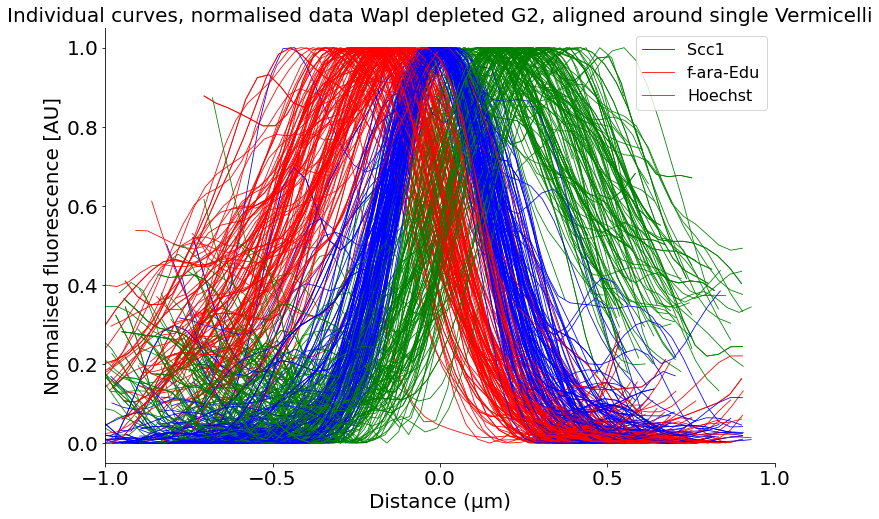

In [57]:
#individual curves, wapl depleted g2, aligned around hoechst and edu peaks

path_plot_profiles_wapl = "/groups/gerlich/experiments/Experiments_005500/005556/wapl_dep/lineprofiles3/"

csv_files = glob.glob(path_plot_profiles_wapl + "*/*.csv")


all_df = []
all_image_names = []
all_distance = []
all_scc1 = []
all_edu = []
all_hoechst = []

#set up empty lists to append
name = []
#scc1 channel
peaks1_scc1 = []
peaks2_scc1 = []
peaks1_value_scc1 = []
peaks2_value_scc1 = []

#edu channel
peaks1_edu = []
peaks1_value_edu = []

#hoechst channel
peaks1_hoechst = []
peaks1_value_hoechst = []

distance_scc1_peaks1_all = []
distance_scc1_peaks2_all = []
distance_edu_peaks_all = []
distance_hoechst_peaks_all = []

for file in csv_files:
    #df = pd.read_csv(file, index_col=0, header=0)
    
    split = file.split(os.sep)
    image_name = split[-2]
    #read in line profiles
    df = pd.read_csv(file, index_col = 0)
    df.columns = ['Distance', 'scc1', 'edu', 'hoechst']
    
    #set distance to variable
    distance = df.loc[:, "Distance"]
   
    #deep copy and then min/max normalisation
    df2 = df.copy()
    for column in df2.columns:
        df2[column] = (df2[column] - df2[column].min()) / (df2[column].max() - df2[column].min())   
        
        df2["Distance"] = distance     

    #subtract edu values from hoechst values

    if np.where(df2['edu']>= df2["hoechst"]):
        df2["hoechst_minus_edu"] = (df2['hoechst'] - df2["edu"])
    
    #subtract hoechst values from edu values
    if np.where(df2['hoechst']>= df2["edu"]):
        df2["edu_minus_hoechst"] = (df2['edu'] - df2["hoechst"])

    #normalisation of subtracted data
    df3 = df2.copy()
    
    df3["hoechst_minus_edu"] = (df3["hoechst_minus_edu"] - df3["hoechst_minus_edu"].min()) / (df3["hoechst_minus_edu"].max() - df3["hoechst_minus_edu"].min())
    df3.rename(columns = {'hoechst_minus_edu':'hoechst_minus_edu_norm'}, inplace = True)

    df3["Distance"] = distance
  
    #drop NaN values
    df3 = df3.dropna(axis=0)
    
    # align individual curves - plot on the same axes
    
    #fit the data using polynomial fit
    #scc1 channel
    p = np.poly1d(np.polyfit(df3["Distance"],df3["scc1"], 10))
    #edu channel
    q = np.poly1d(np.polyfit(df3["Distance"],df3["edu"], 10))
    #normalised hoechst channel
    r = np.poly1d(np.polyfit(df3["Distance"],df3["hoechst_minus_edu_norm"], 10))
    #x-axis values
    
    
    t = np.linspace(0,max(df3["Distance"]), 100)
    peaks_scc1, heights_scc1 = signal.find_peaks(p(t),max(df3["scc1"])*0.6)
    peaks_edu, heights_edu = signal.find_peaks(q(t),max(df3["edu"])*0.6)
    peaks_hoechst, heights_hoechst = signal.find_peaks(r(t),max(df3["hoechst_minus_edu_norm"])*0.6)


    #only consider instances where a single peak has been detected for the hoechst and edu channels
    if len(peaks_edu) == 1 and len(peaks_hoechst) == 1:
    #find the index with the maximum peak value
    #index_max_height_scc1 = np.argmax(heights_scc1)
    #index_max_height_edu = np.argmax(heights_edu)
    #index_max_height_hoechst = np.argmax(heights_hoechst)

        #print([peaks_scc1])
        #print(t[peaks_scc1])

        #print(t[peaks_edu])
        #print(t[peaks_hoechst])
        #slice t, using index of the channel peak to get the distance value for the three channels 
        distance_scc1_peak = t[peaks_scc1]
        distance_edu_peak = t[peaks_edu]
        distance_hoechst_peak = t[peaks_hoechst]

        #append each line profile to each list for the three channels
        peaks1_scc1.append(peaks_scc1[0])
        #peaks2_scc1.append(peaks_scc1[1])
        peaks1_value_scc1.append(heights_scc1['peak_heights'][0])
        distance_scc1_peaks_all.append(distance_scc1_peak[0])

        peaks1_edu.append(peaks_edu[0])
        #peaks2_scc1.append(peaks_scc1[1])
        peaks1_value_edu.append(heights_edu['peak_heights'][0])
        distance_edu_peaks_all.append(distance_edu_peak[0])

        peaks1_hoechst.append(peaks_hoechst[0])
        #peaks2_scc1.append(peaks_scc1[1])
        peaks1_value_hoechst.append(heights_hoechst['peak_heights'][0])
        distance_hoechst_peaks_all.append(distance_hoechst_peak[0])
        
        centre_index = list(map(get_index, peaks1_edu, peaks1_hoechst))
                        
        for i in centre_index:
            values = float(i)
            if values % 1 < 0.5:
                centre = math.floor(values)
            else:
                centre = math.ceil(values)
                        
        norm = t[centre]
        #all_norm.append(norm)
        #print(values, centre)

        x_align_dna = (t-norm)
        y1_align_dna = p(t)
        y2_align_dna = q(t)
        y3_align_dna = r(t)
        
        x_norm_aligned_dna = ((df2 ["Distance"])-norm)
        y1_norm_aligned_dna = ((df2["scc1"]))
        y2_norm_aligned_dna = ((df2["edu"]))
        y3_norm_aligned_dna = ((df3["hoechst_minus_edu_norm"]))       
               
        centre_index_single_axis = list(map(get_index_single_axis, peaks_scc1))

        for i in centre_index_single_axis:
            centre_axis = int(i)
            centre_axis
        norm_axis = t[centre_axis]
        #print(centre_axis, norm_axis)
            
        x_align_axis = (t-norm_axis)
        y1_align_axis = p(t)
        y2_align_axis = q(t)
        y3_align_axis = r(t)
        
        x_norm_aligned_axis = ((df2 ["Distance"])-norm_axis)
        y1_norm_aligned_axis = ((df2["scc1"]))
        y2_norm_aligned_axis = ((df2["edu"]))
        y3_norm_aligned_axis = ((df3["hoechst_minus_edu_norm"]))       
        
        #append image name
        name.append(image_name)               
    
    #plot data, individual curves
    #fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (25,5))
    plt.plot(x_norm_aligned_axis, y1_norm_aligned_axis, c='b', label='Scc1', linewidth=0.8)
    plt.plot(x_norm_aligned_axis, y2_norm_aligned_axis, c='r', label='F-ara-Edu', linewidth=0.8)
    plt.plot(x_norm_aligned_axis, y3_norm_aligned_axis, c='g', label='Hoechst', linewidth=0.8)
    fig = plt.gcf()
    fig.set_size_inches(12, 8)
    labels = ['Scc1', 'F-ara-EdU', 'Hoechst']
    plt.legend(["Scc1", "f-ara-Edu", "Hoechst"], fontsize=16, loc='best')
    plt.xlabel("Distance (µm)", fontsize=20)
    plt.ylabel("Normalised fluorescence [AU]", fontsize=20) 
    #plt.ylim(-0,2, 1.2)
    plt.xlim([-1, 1])
    plt.tick_params(axis='x', labelsize=20)
    plt.tick_params(axis='y', labelsize=20)
    x_ticks = [-1, -0.5, 0, 0.5, 1]
    #specify x-axis labels
    #add x-axis values to plot
    plt.xticks(ticks=x_ticks)
    plt.title("Individual curves, normalised data Wapl depleted G2, aligned around single Vermicelli", fontsize=20)
    #fig.legend(handles, labels, loc='center right',prop={"size":16})

    
    sns.despine()
    
    results_dir = "/groups/gerlich/experiments/Experiments_005500/005556/"
    figsave = fig.get_figure()
    df1.to_csv(resultsdir + "sep_around_axes_" + tail + ".csv")
    figsave.savefig(results_dir + "wapl_dep_g2_individual_curves_aligned_around_single_vermicelli.png", bbox_inches = "tight")
        
    
#all_df.append(df3)
#all_frames = pd.concat(all_df, axis=1, ignore_index=False)




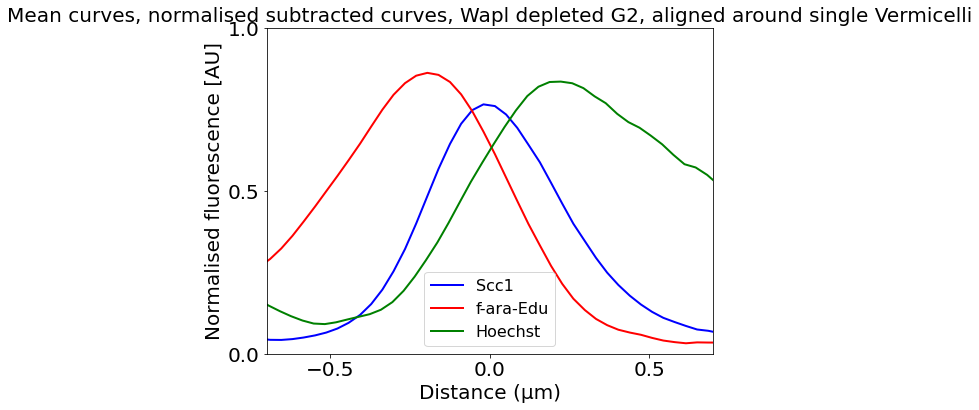

In [65]:
#plotting aligned mean curves with standard deviation as the error bars, wt late prometaphase
#read in data
path_plot_profiles_wapl = "/groups/gerlich/experiments/Experiments_005500/005556/wapl_dep/lineprofiles3/"

csv_files = glob.glob(path_plot_profiles_wapl + "*/*.csv")

all_df = []
all_image_names = []
all_distances = []
all_scc1 = []
all_edu = []
all_hoechst = []

#set up empty lists to append
name = []
#scc1 channel
peaks1_scc1 = []
peaks2_scc1 = []
peaks1_value_scc1 = []
peaks2_value_scc1 = []

#edu channel
peaks1_edu = []
peaks1_value_edu = []

#hoechst channel
peaks1_hoechst = []
peaks1_value_hoechst = []

distance_scc1_peaks1_all = []
distance_scc1_peaks2_all = []
distance_scc1_peaks_all = []
distance_edu_peaks_all = []
distance_hoechst_peaks_all = []

for file in csv_files:
    #df = pd.read_csv(file, index_col=0, header=0)
    condition = "wapl_dep"
    split = file.split(os.sep)
    image_name = split[-2]

    #read in line profiles
    df = pd.read_csv(file, index_col = 0)
    df.columns = ['Distance', 'scc1', 'edu', 'hoechst']
    
    #set distance to variable
    distance = df.loc[:, "Distance"]
   
    #deep copy and then min/max normalisation
    df2 = df.copy()
    for column in df2.columns:
        df2[column] = (df2[column] - df2[column].min()) / (df2[column].max() - df2[column].min())   
        
        df2["Distance"] = distance     

    #subtract edu values from hoechst values

    if np.where(df2['edu']>= df2["hoechst"]):
        df2["hoechst_minus_edu"] = (df2['hoechst'] - df2["edu"])
    
    #subtract hoechst values from edu values
    if np.where(df2['hoechst']>= df2["edu"]):
        df2["edu_minus_hoechst"] = (df2['edu'] - df2["hoechst"])

    #normalisation of subtracted data
    df3 = df2.copy()
    
    df3["hoechst_minus_edu"] = (df3["hoechst_minus_edu"] - df3["hoechst_minus_edu"].min()) / (df3["hoechst_minus_edu"].max() - df3["hoechst_minus_edu"].min())
    df3.rename(columns = {'hoechst_minus_edu':'hoechst_minus_edu_norm'}, inplace = True)

    df3["distance"] = distance
  
    #drop NaN values
    df3 = df3.dropna(axis=0)    

    #define variables
    distance = df3["distance"]
    scc1=df3["scc1"]
    edu=df3["edu"]
    hoechst = df3["hoechst_minus_edu_norm"]
    
    #for each profile
    all_image_names.append(image_name)
    all_distances.append(distance)
    all_scc1.append(scc1)
    all_edu.append(edu)
    all_hoechst.append(hoechst)   


#concat all values into dataframes, for each variable (each x position)
frame_distances = pd.concat(all_distances, axis=1, ignore_index=False)
frame_scc1 = pd.concat(all_scc1, axis=1, ignore_index=False)
frame_edu = pd.concat(all_edu, axis=1, ignore_index=False)
frame_hoechst = pd.concat(all_hoechst, axis=1, ignore_index=False)

#calculate mean for each row (each x position)  
mean_distance = (frame_distances.mean(axis=1))
mean_scc1 = (frame_scc1.mean(axis=1))
mean_edu = (frame_edu.mean(axis=1))
mean_hoechst = (frame_hoechst.mean(axis=1))

#calculate standard deviation for each row
sd_distance = (frame_distances.std(axis=1))
sd_scc1 = (frame_scc1.std(axis=1))
sd_edu = (frame_edu.std(axis=1))
sd_hoechst = (frame_hoechst.std(axis=1))

#concat dataframes back
mean_frames = [mean_distance, mean_scc1, mean_edu, mean_hoechst]
all_mean_frames = pd.concat(mean_frames, axis=1, ignore_index=False)
all_mean_frames.columns = ["distance", "scc1", "edu", "hoechst"]

sd_frames = [sd_distance, sd_scc1, sd_edu, sd_hoechst]
all_std_frames = pd.concat(sd_frames, axis=1, ignore_index=False)
all_std_frames.columns = ["distance", "scc1", "edu", "hoechst"]
all_std_frames.columns = ["distance", "std_scc1", "std_edu", "std_hoechst"]


# align individual curves - plot on the same axes

#fit the data using polynomial fit
#scc1 channel
p = np.poly1d(np.polyfit(all_mean_frames["distance"],all_mean_frames["scc1"], 10))
#edu channel
q = np.poly1d(np.polyfit(all_mean_frames["distance"],all_mean_frames["edu"], 10))
#normalised hoechst channel
r = np.poly1d(np.polyfit(all_mean_frames["distance"],all_mean_frames["hoechst"], 10))
#x-axis values


t = np.linspace(0,max(all_mean_frames["distance"]), 1000)
peaks_scc1, heights_scc1 = signal.find_peaks(p(t),max(all_mean_frames["scc1"])*0.6)
peaks_edu, heights_edu = signal.find_peaks(q(t),max(all_mean_frames["edu"])*0.6)
peaks_hoechst, heights_hoechst = signal.find_peaks(r(t),max(all_mean_frames["hoechst"])*0.6)


#only consider instances where a single peak has been detected for the hoechst and edu channels
if len(peaks_edu) == 1 and len(peaks_hoechst) == 1 and len(peaks_scc1)==1:

    distance_scc1_peak = t[peaks_scc1]
    distance_edu_peak = t[peaks_edu]
    distance_hoechst_peak = t[peaks_hoechst]

    #append each line profile to each list for the three channels
    peaks1_scc1.append(peaks_scc1[0])
    #peaks2_scc1.append(peaks_scc1[1])
    peaks1_value_scc1.append(heights_scc1['peak_heights'][0])
    distance_scc1_peaks_all.append(distance_scc1_peak[0])

    peaks1_edu.append(peaks_edu[0])
    #peaks2_scc1.append(peaks_scc1[1])
    peaks1_value_edu.append(heights_edu['peak_heights'][0])
    distance_edu_peaks_all.append(distance_edu_peak[0])

    peaks1_hoechst.append(peaks_hoechst[0])
    #peaks2_scc1.append(peaks_scc1[1])
    peaks1_value_hoechst.append(heights_hoechst['peak_heights'][0])
    distance_hoechst_peaks_all.append(distance_hoechst_peak[0])

    centre_index = list(map(get_index, peaks1_edu, peaks1_hoechst))

    for i in centre_index:
        values = float(i)
        if values % 1 < 0.5:
            centre = math.floor(values)
        else:
            centre = math.ceil(values)

    norm = t[centre]
    #all_norm.append(norm)
    #print(values, centre)

    x_align_dna = (t-norm)
    y1_align_dna = p(t)
    y2_align_dna = q(t)
    y3_align_dna = r(t)

    x_norm_aligned_dna = ((all_mean_frames["distance"])-norm)
    y1_norm_aligned_dna = ((all_mean_frames["scc1"]))
    y2_norm_aligned_dna = ((all_mean_frames["edu"]))
    y3_norm_aligned_dna = ((all_mean_frames["hoechst"]))    
    
    
    x_norm_aligned_std = ((all_std_frames["distance"])-norm)
    y1_norm_aligned_std = ((all_std_frames["std_scc1"]))
    y2_norm_aligned_std = ((all_std_frames["std_edu"]))
    y3_norm_aligned_std = ((all_std_frames["std_hoechst"]))
    

    centre_index_single_axis = list(map(get_index_single_axis, peaks_scc1))

    for i in centre_index_single_axis:
        centre_axis = int(i)
        centre_axis
    norm_axis = t[centre_axis]
    #print(centre_axis, norm_axis)

    x_align_axis = (t-norm_axis)
    y1_align_axis = p(t)
    y2_align_axis = q(t)
    y3_align_axis = r(t)

    x_norm_aligned_axis = ((all_mean_frames["distance"])-norm_axis)
    y1_norm_aligned_axis = ((all_mean_frames["scc1"]))
    y2_norm_aligned_axis = ((all_mean_frames["edu"]))
    y3_norm_aligned_axis = ((all_mean_frames["hoechst"]))   
    
    x_norm_aligned_axis_std = ((all_std_frames["distance"])-norm_axis)
    y1_norm_aligned_axis_std = ((all_std_frames["std_scc1"]))
    y2_norm_aligned_axis_std = ((all_std_frames["std_edu"]))
    y3_norm_aligned_axis_std = ((all_std_frames["std_hoechst"]))


#plot mean curves with standard deviation error bars, aligned around hoechst and edu peaks

plt.plot(x_norm_aligned_axis, y1_norm_aligned_axis, color='blue', linewidth=2)
#plt.fill_between(x_norm_aligned_axis, y1_norm_aligned_axis - y1_norm_aligned_axis_std,
                #y1_norm_aligned_axis + y1_norm_aligned_axis_std, color='blue', alpha=0.1)

plt.plot(x_norm_aligned_axis, y2_norm_aligned_axis, color='red', linewidth=2)
#plt.fill_between(x_norm_aligned_axis, y2_norm_aligned_axis - y2_norm_aligned_axis_std,
                #y2_norm_aligned_axis + y2_norm_aligned_axis_std, color='red', alpha=0.1)


plt.plot(x_norm_aligned_dna, y3_norm_aligned_dna, color='green', linewidth=2)
#plt.fill_between(x_norm_aligned_axis, y3_norm_aligned_axis - y3_norm_aligned_axis_std,
                #y3_norm_aligned_axis + y3_norm_aligned_axis_std, color='green', alpha=0.1)

fig = plt.gcf()
fig.set_size_inches(8, 6)
labels = ['Scc1', 'F-ara-EdU', 'Hoechst']
plt.legend(["Scc1", "f-ara-Edu", "Hoechst"], fontsize=16, loc='best')
plt.xlabel("Distance (µm)", fontsize=20)
plt.ylabel("Normalised fluorescence [AU]", fontsize=20)  
plt.tick_params(axis='x', labelsize=20)
plt.tick_params(axis='y', labelsize=20)

plt.xlim([-0.7, 0.7])
plt.ylim([0, 1.0])
x_ticks = [-0.5, 0, 0.5]
y_ticks=[0, 0.5, 1.0]



#specify x-axis labels
#add x-axis values to plot
plt.xticks(ticks=x_ticks)
plt.yticks(ticks=y_ticks)
plt.title("Mean curves, normalised subtracted curves, Wapl depleted G2, aligned around single Vermicelli", fontsize=20)
#fig.legend(handles, labels, loc='center right',prop={"size":16})


results_dir = "/groups/gerlich/members/PaulBatty/Paper_preparation/figures/dropbox/fig3/radial_displacement_around_axis/"

figsave = fig.get_figure()
#df1.to_csv(resultsdir + "sep_around_axes_" + tail + ".csv")
figsave.savefig(results_dir + "wapl_dep_g2_mean_curves_aligned_around_single_vermicelli.pdf", bbox_inches = "tight")